In [1]:
import meep as mp
import meep.adjoint as mpa
from meep import Animate2D
import numpy as np
from autograd import numpy as npa
from autograd import tensor_jacobian_product, grad
import nlopt
from matplotlib import pyplot as plt
from matplotlib.patches import Circle
from meep.materials import Ag
import os
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from PIL import Image
#from meep.materials import c-Si


os.makedirs(f'PICTURE',exist_ok=True)
mp.verbosity(0)
TiO2 = mp.Medium(index=2.6)
SiO2 = mp.Medium(index=1.44)
Si = mp.Medium(index=3.4)
Air = mp.Medium(index=1)

In [2]:
resolution = 100
design_region_resolution = int(resolution)

design_region_x_width  = 1   #100 nm
design_region_y_height = 1   #100 nm
design_region_z_height = 0.01  #20 nm or 10nm

pml_size = 1.0
pml_layers = [mp.PML(pml_size,direction=mp.Z)]

Sz_size = 0.6
Sx = design_region_x_width
Sy = design_region_y_height 
Sz = 2 * pml_size + design_region_z_height + Sz_size
cell_size = mp.Vector3(Sx, Sy, Sz)

wavelengths = np.array([1.55])     # wavelengths = np.array([1.5 ,1.55, 1.6])
frequencies = np.array([1 / 1.55])

nf = 1                 #3 #wavelengths Number

minimum_length = 0.01  # minimum length scale (microns)
eta_i = 0.5            # blueprint (or intermediate) design field thresholding point (between 0 and 1)
eta_e = 0.55           # erosion design field thresholding point (between 0 and 1)
eta_d = 1 - eta_e      # dilation design field thresholding point (between 0 and 1)
filter_radius = mpa.get_conic_radius_from_eta_e(minimum_length, eta_e)

Source_distance = -0.2

fcen   = 1 / 1.55
width  = 0.2  
fwidth = width * fcen
source_center = mp.Vector3(0,0,Source_distance)  
source_size   = mp.Vector3(design_region_x_width, design_region_y_height, 0)
src    = mp.GaussianSource(frequency=fcen, fwidth=fwidth, is_integrated=True)
source = [mp.Source(src, component=mp.Ey, size=source_size, center=source_center)]   

Nx = int(design_region_resolution * design_region_x_width) + 1
Ny = int(design_region_resolution * design_region_y_height) + 1
Nz = 1

design_variables = mp.MaterialGrid(mp.Vector3(Nx, Ny, Nz), Air, Si, grid_type="U_MEAN")
design_region    = mpa.DesignRegion(
            design_variables,
            volume=mp.Volume(
            center=mp.Vector3(0,0,0),
            size=mp.Vector3(design_region_x_width, design_region_y_height, design_region_z_height),
            ),
)

def mapping(x, eta, beta):
    # filter
    filtered_field = mpa.conic_filter(
        x,
        filter_radius,
        design_region_x_width,
        design_region_y_height,
        design_region_resolution,
    )
    # projection
    projected_field = mpa.tanh_projection(filtered_field, beta, eta)
    projected_field = (npa.fliplr(projected_field) + projected_field) / 2
    projected_field = (npa.flipud(projected_field) + projected_field) / 2  # left-right symmetry    
    
    return projected_field.flatten()


geometry = [mp.Block(center=design_region.center, size=design_region.size, material=design_variables)]

kpoint = mp.Vector3()
sim = mp.Simulation(
    cell_size        = cell_size,
    boundary_layers  = pml_layers,
    geometry         = geometry,
    sources          = source,
    default_material = Air,
    k_point          = kpoint,
    symmetries       = [mp.Mirror(direction=mp.X)],
    resolution       = resolution,
    extra_materials  = [Ag],       # Introducing metal complex terms
)
#---------------------------------------------------------------------------------------------------#


#-----------------[4]---------------------------------#
monitor_position   = mp.Vector3(0, 0, 0)       # Focus position
monitor_size       = mp.Vector3(0.01,0.01,0.01)     # Focus Size//////0.11
FourierFields_x    = mpa.FourierFields(sim,mp.Volume(center=monitor_position,size=monitor_size),mp.Ex,yee_grid=True)
FourierFields_y    = mpa.FourierFields(sim,mp.Volume(center=monitor_position,size=monitor_size),mp.Ey,yee_grid=True)
FourierFields_z    = mpa.FourierFields(sim,mp.Volume(center=monitor_position,size=monitor_size),mp.Ez,yee_grid=True)
ob_list            = [FourierFields_x,FourierFields_y,FourierFields_z]


def J(fields_x,fields_y,fields_z):
    ET_x = npa.abs(fields_x) ** 2
    ET_y = npa.abs(fields_y) ** 2
    ET_z = npa.abs(fields_z) ** 2
    ET = npa.sqrt( npa.mean(ET_x) + npa.mean(ET_y) + npa.mean(ET_z) )  
    return ET


opt = mpa.OptimizationProblem(
    simulation=sim,
    objective_functions=[J],
    objective_arguments=ob_list,
    design_regions=[design_region],
    frequencies=frequencies,
    decimation_factor = 1 ,           # KEY BUG!!
    maximum_run_time=50,
)

[0.5 0.5 0.5 ... 0.5 0.5 0.5]
2
0.5
4
[0.5 0.5 0.5 ... 0.5 0.5 0.5]


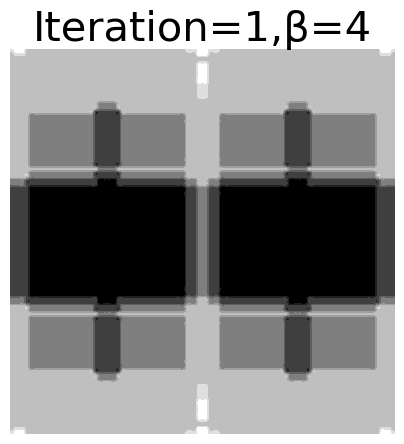

[0.50387394 0.50271265 0.50223604 ... 0.50223604 0.50271265 0.50387394]
2
0.5
4
[0.5 0.5 0.5 ... 0.5 0.5 0.5]


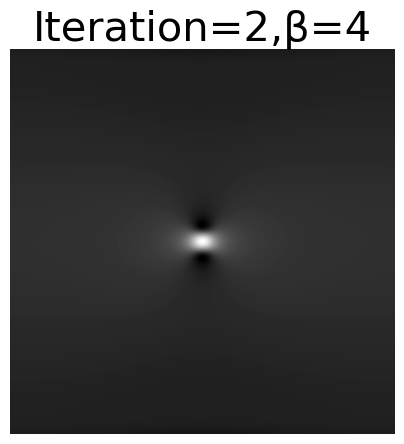

[0.54403246 0.53212828 0.52704165 ... 0.52704165 0.53212828 0.54403246]
2
0.5
4
[0.5 0.5 0.5 ... 0.5 0.5 0.5]


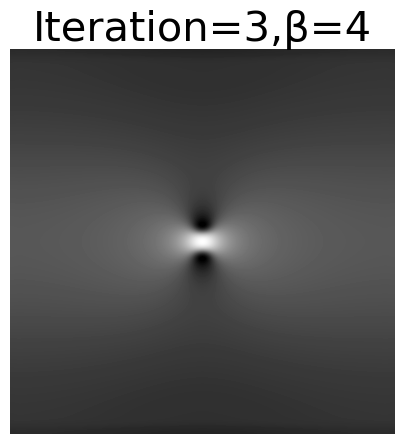

[0.96016348 0.92274258 0.9058953  ... 0.9058953  0.92274258 0.96016348]
2
0.5
4
[0.5 0.5 0.5 ... 0.5 0.5 0.5]


/home/ming/anaconda3/envs/mp/lib/python3.8/site-packages/meep/geom.py:588: UserWarning: The weights parameter of MaterialGrid must be in the range [0,1].
  warnings.warn(


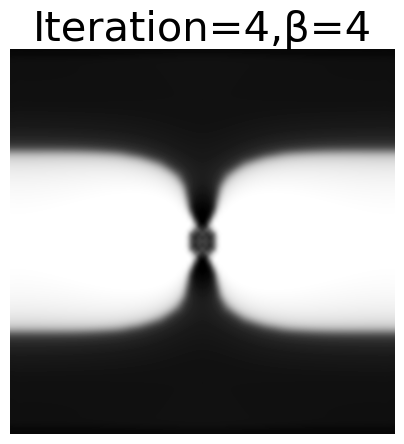

[0.74249195 0.69915291 0.68109638 ... 0.68109638 0.69915291 0.74249195]
2
0.5
4
[0.5 0.5 0.5 ... 0.5 0.5 0.5]


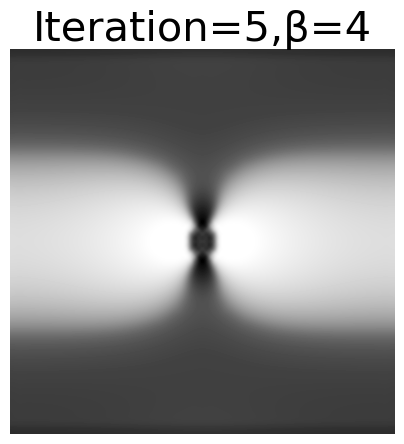

[0.59210974 0.56842931 0.55908332 ... 0.55908332 0.56842931 0.59210974]
2
0.5
4
[0.5 0.5 0.5 ... 0.5 0.5 0.5]


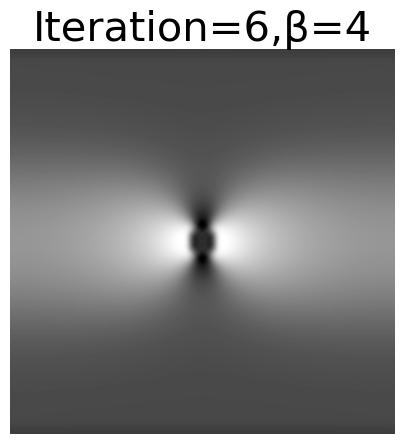

[0.55501481 0.54015763 0.53404715 ... 0.53404715 0.54015763 0.55501481]
2
0.5
4
[0.5 0.5 0.5 ... 0.5 0.5 0.5]


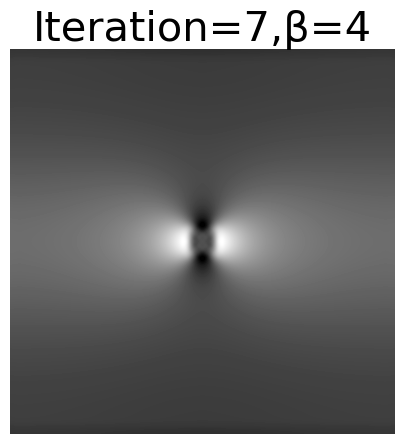

[0.54689179 0.53420342 0.52884756 ... 0.52884756 0.53420342 0.54689179]
2
0.5
4
[0.5 0.5 0.5 ... 0.5 0.5 0.5]


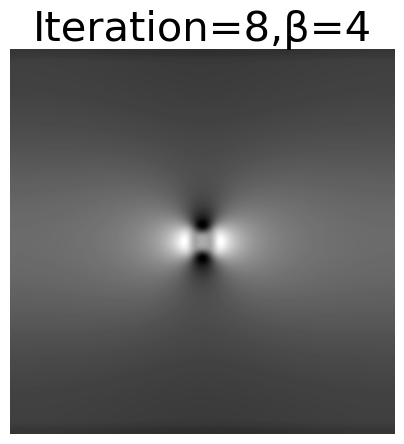

[0.54481699 0.53269657 0.52753588 ... 0.52753588 0.53269657 0.54481699]
2
0.5
4
[0.5 0.5 0.5 ... 0.5 0.5 0.5]


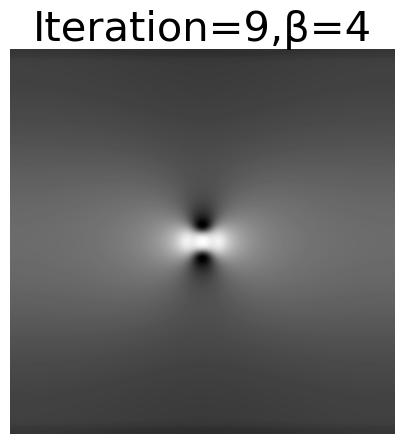

[0.54422872 0.53227037 0.5271652  ... 0.5271652  0.53227037 0.54422872]
2
0.5
4
[0.5 0.5 0.5 ... 0.5 0.5 0.5]


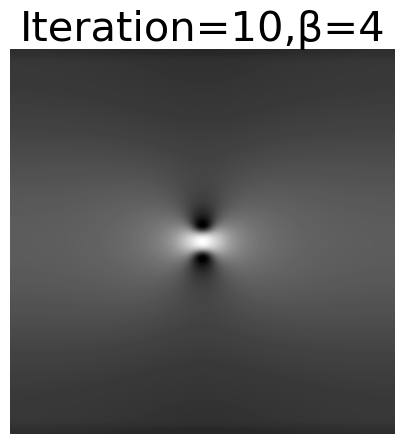

[0.54407127 0.53215638 0.52706608 ... 0.52706608 0.53215638 0.54407127]
2
0.5
4
[0.5 0.5 0.5 ... 0.5 0.5 0.5]


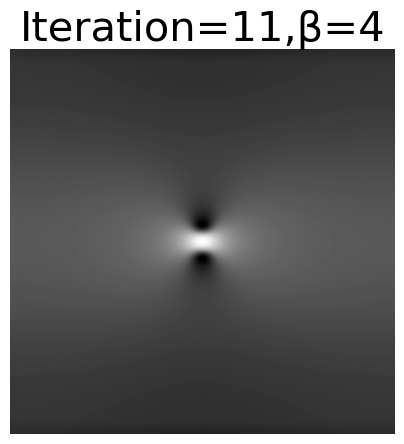

[0.54404186 0.53213509 0.52704757 ... 0.52704757 0.53213509 0.54404186]
2
0.5
4
[0.5 0.5 0.5 ... 0.5 0.5 0.5]


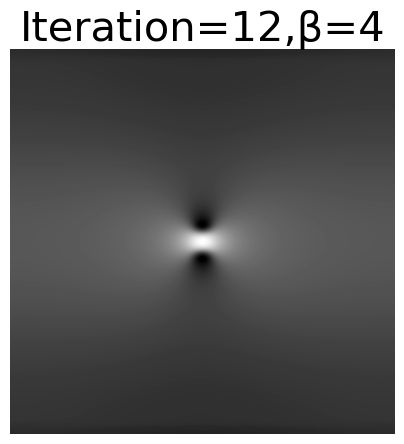

[0.54403592 0.53213079 0.52704383 ... 0.52704383 0.53213079 0.54403592]
2
0.5
4
[0.5 0.5 0.5 ... 0.5 0.5 0.5]


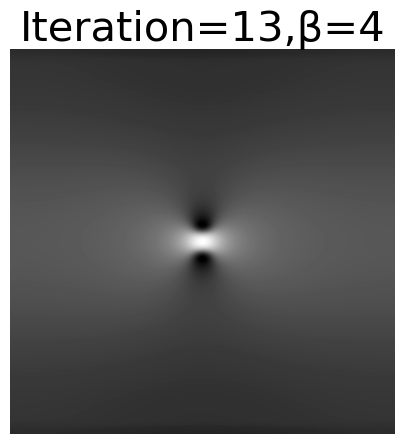

[0.54403391 0.53212934 0.52704257 ... 0.52704257 0.53212934 0.54403391]
2
0.5
4
[0.5 0.5 0.5 ... 0.5 0.5 0.5]


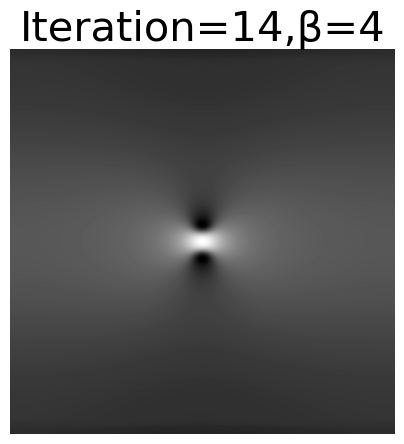

[0.5440331  0.53212875 0.52704206 ... 0.52704206 0.53212875 0.5440331 ]
2
0.5
4
[0.5 0.5 0.5 ... 0.5 0.5 0.5]


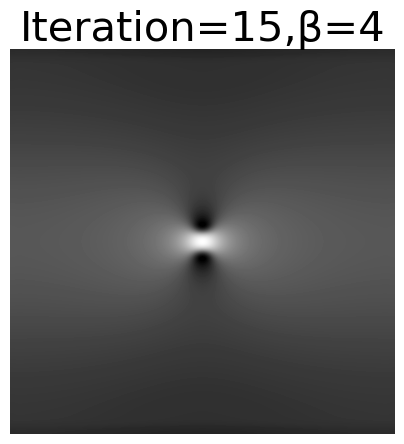

[0.54403246 0.53212828 0.52704165 ... 0.52704165 0.53212828 0.54403246]
2
0.5
8
[0.54403246 0.53212828 0.52704165 ... 0.52704165 0.53212828 0.54403246]


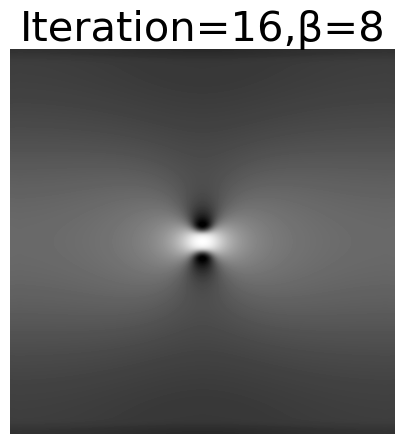

[0.65582312 0.62418776 0.61266959 ... 0.61266959 0.62418776 0.65582312]
2
0.5
8
[0.54403246 0.53212828 0.52704165 ... 0.52704165 0.53212828 0.54403246]


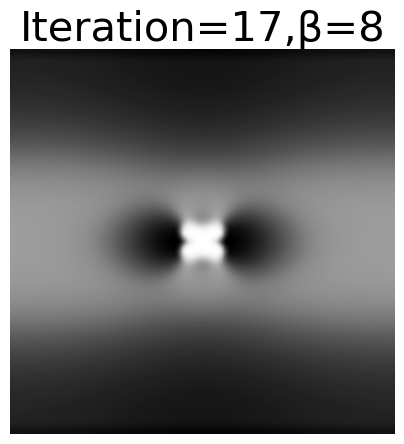

[0.56131693 0.54524212 0.53892351 ... 0.53892351 0.54524212 0.56131693]
2
0.5
8
[0.54403246 0.53212828 0.52704165 ... 0.52704165 0.53212828 0.54403246]


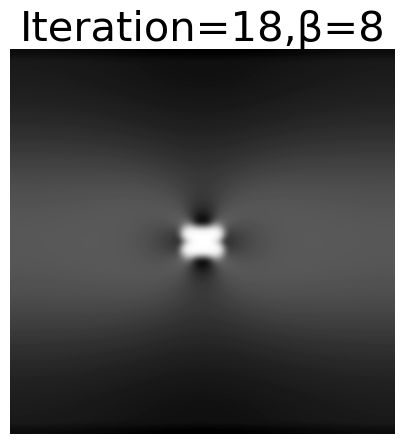

[0.54587327 0.53350366 0.52828221 ... 0.52828221 0.53350366 0.54587327]
2
0.5
8
[0.54403246 0.53212828 0.52704165 ... 0.52704165 0.53212828 0.54403246]


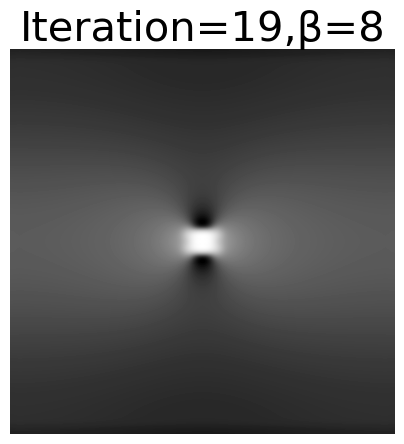

[0.54433373 0.53235304 0.52724428 ... 0.52724428 0.53235304 0.54433373]
2
0.5
8
[0.54403246 0.53212828 0.52704165 ... 0.52704165 0.53212828 0.54403246]


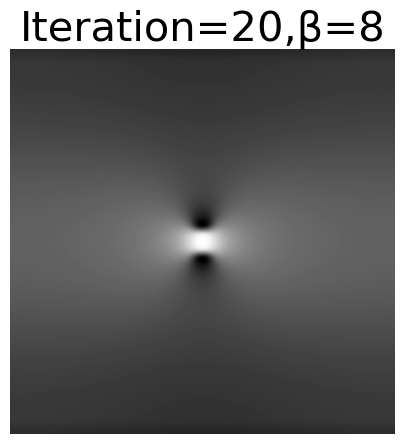

[0.54412532 0.53219755 0.52710409 ... 0.52710409 0.53219755 0.54412532]
2
0.5
8
[0.54403246 0.53212828 0.52704165 ... 0.52704165 0.53212828 0.54403246]


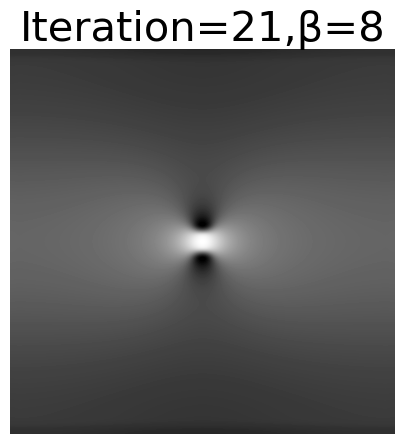

[0.54406654 0.53215371 0.52706457 ... 0.52706457 0.53215371 0.54406654]
2
0.5
8
[0.54403246 0.53212828 0.52704165 ... 0.52704165 0.53212828 0.54403246]


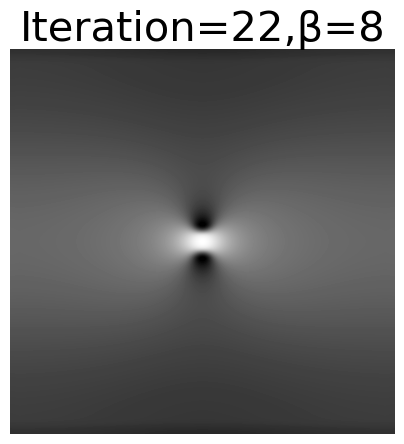

[0.54408729 0.53216919 0.52707855 ... 0.52707855 0.53216919 0.54408729]
2
0.5
8
[0.54403246 0.53212828 0.52704165 ... 0.52704165 0.53212828 0.54403246]


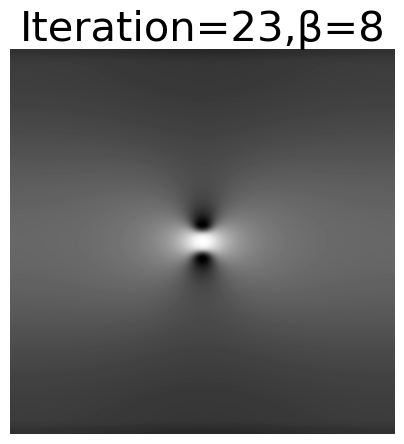

[0.54410139 0.53217971 0.52708805 ... 0.52708805 0.53217971 0.54410139]
2
0.5
8
[0.54403246 0.53212828 0.52704165 ... 0.52704165 0.53212828 0.54403246]


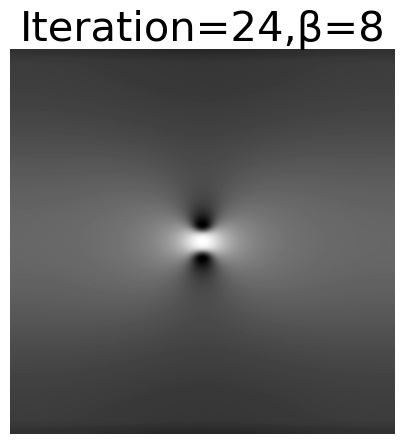

[0.54410865 0.53218513 0.52709294 ... 0.52709294 0.53218513 0.54410865]
2
0.5
8
[0.54403246 0.53212828 0.52704165 ... 0.52704165 0.53212828 0.54403246]


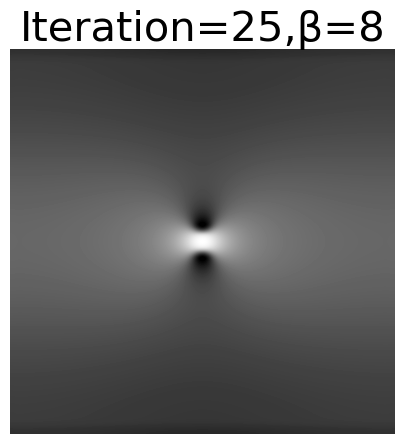

[0.54418242 0.53224018 0.52714262 ... 0.52714262 0.53224018 0.54418242]
2
0.5
8
[0.54403246 0.53212828 0.52704165 ... 0.52704165 0.53212828 0.54403246]


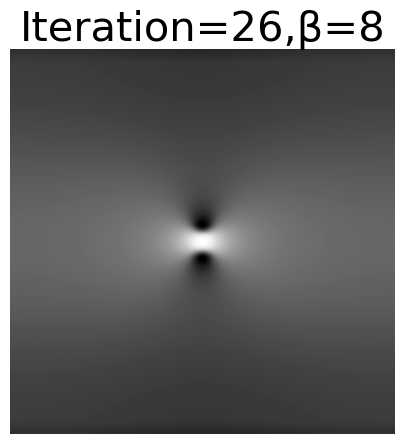

[0.54414017 0.53220865 0.52711416 ... 0.52711416 0.53220865 0.54414017]
2
0.5
8
[0.54403246 0.53212828 0.52704165 ... 0.52704165 0.53212828 0.54403246]


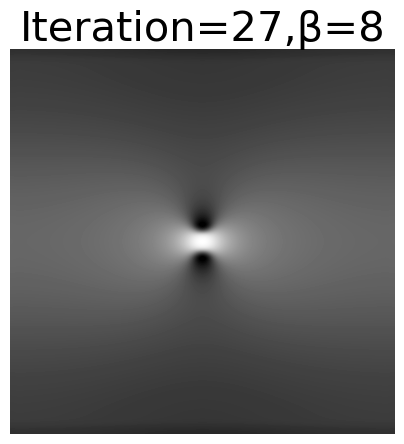

[0.54415607 0.53222051 0.52712487 ... 0.52712487 0.53222051 0.54415607]
2
0.5
8
[0.54403246 0.53212828 0.52704165 ... 0.52704165 0.53212828 0.54403246]


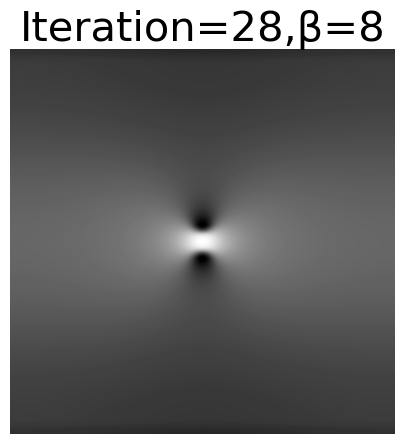

[0.54438441 0.53239094 0.52727868 ... 0.52727868 0.53239094 0.54438441]
2
0.5
8
[0.54403246 0.53212828 0.52704165 ... 0.52704165 0.53212828 0.54403246]


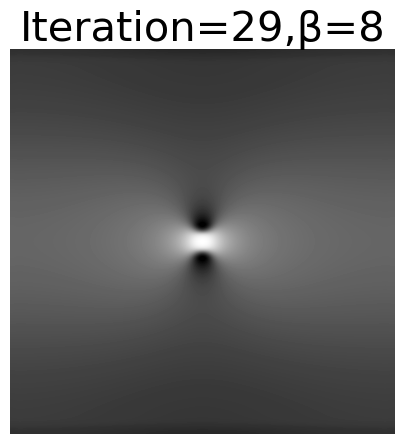

[0.54421737 0.53226626 0.52716615 ... 0.52716615 0.53226626 0.54421737]
2
0.5
8
[0.54403246 0.53212828 0.52704165 ... 0.52704165 0.53212828 0.54403246]


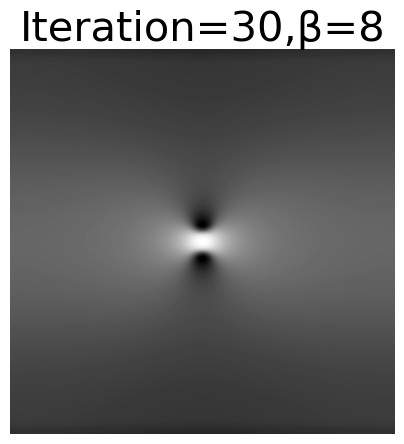

[0.54415607 0.53222051 0.52712487 ... 0.52712487 0.53222051 0.54415607]
2
0.5
16
[0.54415607 0.53222051 0.52712487 ... 0.52712487 0.53222051 0.54415607]


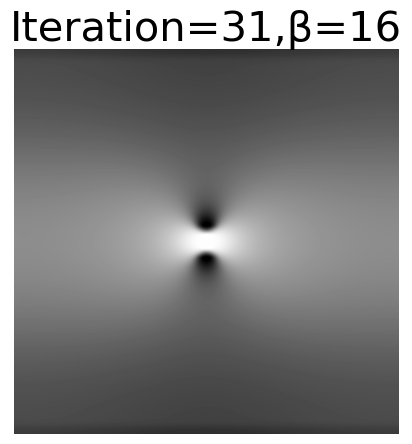

[0.56697605 0.55084182 0.54552386 ... 0.54552386 0.55084182 0.56697605]
2
0.5
16
[0.54415607 0.53222051 0.52712487 ... 0.52712487 0.53222051 0.54415607]


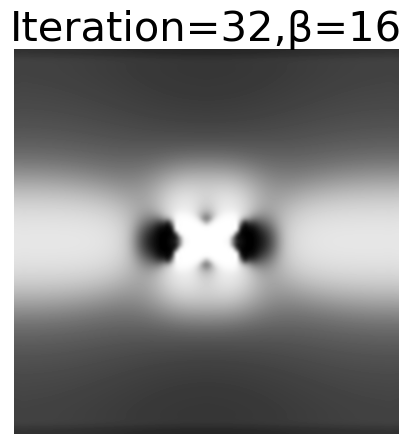

[0.54821601 0.53548636 0.53034928 ... 0.53034928 0.53548636 0.54821601]
2
0.5
16
[0.54415607 0.53222051 0.52712487 ... 0.52712487 0.53222051 0.54415607]


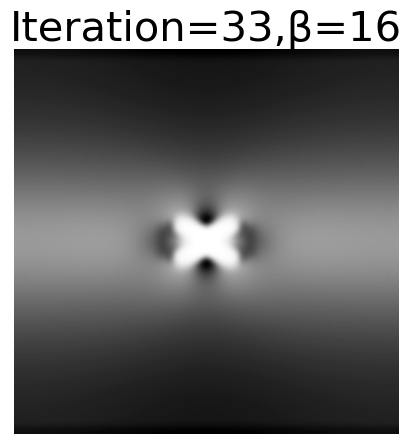

[0.54517026 0.53303438 0.52792831 ... 0.52792831 0.53303438 0.54517026]
2
0.5
16
[0.54415607 0.53222051 0.52712487 ... 0.52712487 0.53222051 0.54415607]


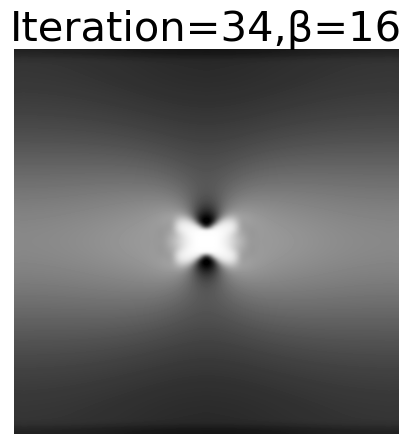

[0.544495   0.53249235 0.52739322 ... 0.52739322 0.53249235 0.544495  ]
2
0.5
16
[0.54415607 0.53222051 0.52712487 ... 0.52712487 0.53222051 0.54415607]


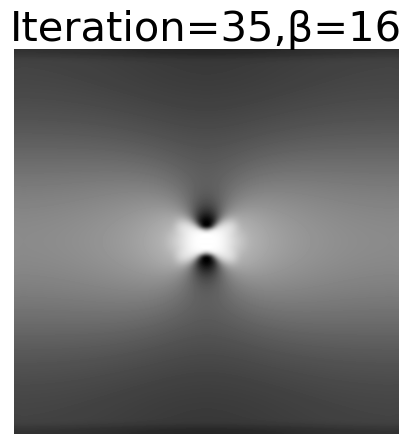

[0.54466835 0.5326316  0.52753104 ... 0.52753104 0.5326316  0.54466835]
2
0.5
16
[0.54415607 0.53222051 0.52712487 ... 0.52712487 0.53222051 0.54415607]


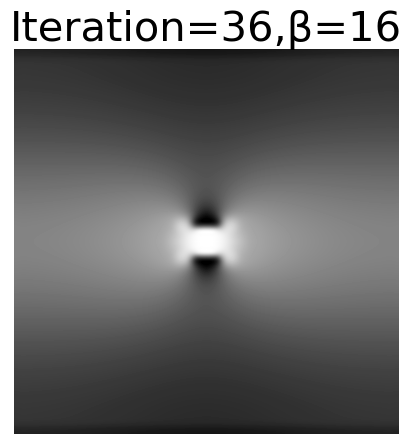

[0.54455393 0.53253969 0.52744007 ... 0.52744007 0.53253969 0.54455393]
2
0.5
16
[0.54415607 0.53222051 0.52712487 ... 0.52712487 0.53222051 0.54415607]


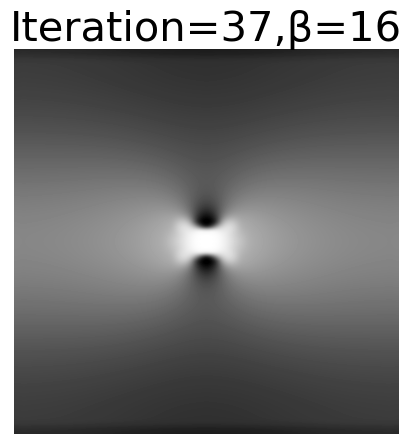

[0.54451731 0.53251027 0.52741095 ... 0.52741095 0.53251027 0.54451731]
2
0.5
16
[0.54415607 0.53222051 0.52712487 ... 0.52712487 0.53222051 0.54415607]


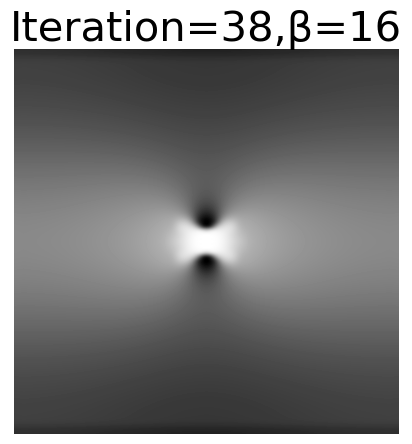

[0.54450248 0.53249836 0.52739916 ... 0.52739916 0.53249836 0.54450248]
2
0.5
16
[0.54415607 0.53222051 0.52712487 ... 0.52712487 0.53222051 0.54415607]


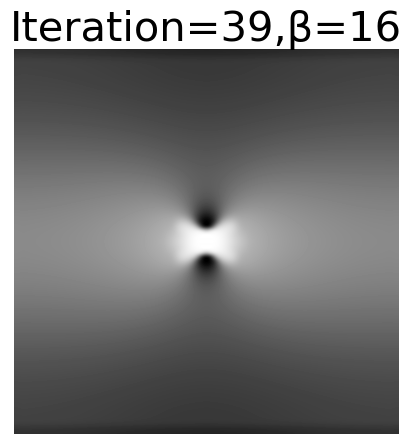

[0.54464685 0.53261428 0.52751377 ... 0.52751377 0.53261428 0.54464685]
2
0.5
16
[0.54415607 0.53222051 0.52712487 ... 0.52712487 0.53222051 0.54415607]


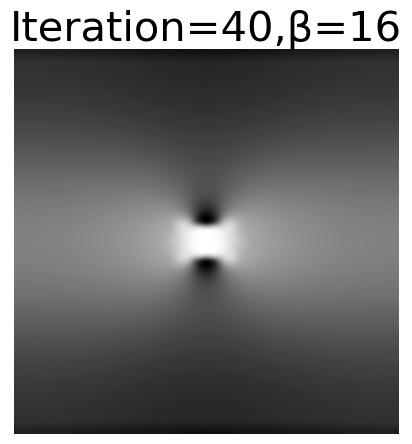

[0.54454707 0.53253416 0.52743456 ... 0.52743456 0.53253416 0.54454707]
2
0.5
16
[0.54415607 0.53222051 0.52712487 ... 0.52712487 0.53222051 0.54415607]


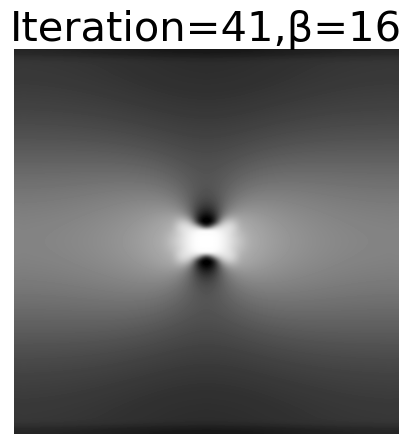

[0.54451859 0.53251129 0.52741195 ... 0.52741195 0.53251129 0.54451859]
2
0.5
16
[0.54415607 0.53222051 0.52712487 ... 0.52712487 0.53222051 0.54415607]


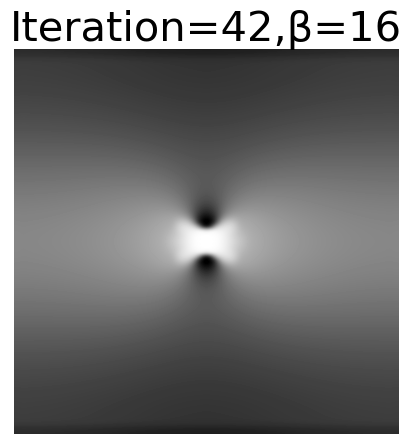

[0.54450875 0.5325034  0.52740414 ... 0.52740414 0.5325034  0.54450875]
2
0.5
16
[0.54415607 0.53222051 0.52712487 ... 0.52712487 0.53222051 0.54415607]


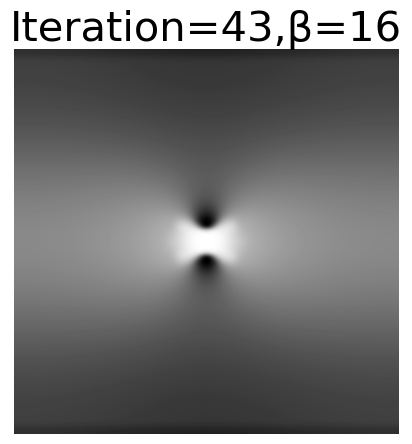

[0.54450459 0.53250005 0.52740084 ... 0.52740084 0.53250005 0.54450459]
2
0.5
16
[0.54415607 0.53222051 0.52712487 ... 0.52712487 0.53222051 0.54415607]


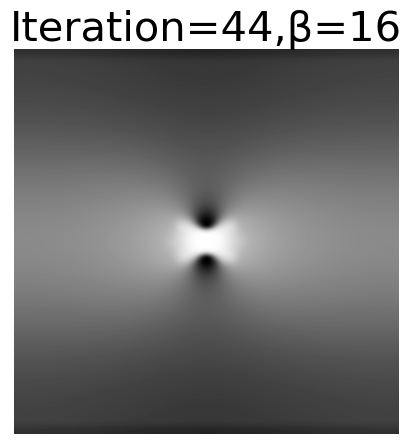

[0.54450328 0.53249901 0.5273998  ... 0.5273998  0.53249901 0.54450328]
2
0.5
16
[0.54415607 0.53222051 0.52712487 ... 0.52712487 0.53222051 0.54415607]


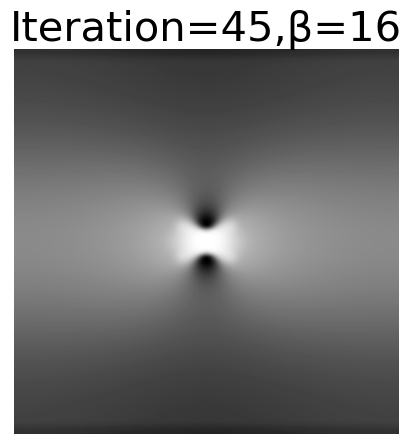

[0.54450328 0.53249901 0.5273998  ... 0.5273998  0.53249901 0.54450328]
2
0.5
32
[0.54450328 0.53249901 0.5273998  ... 0.5273998  0.53249901 0.54450328]


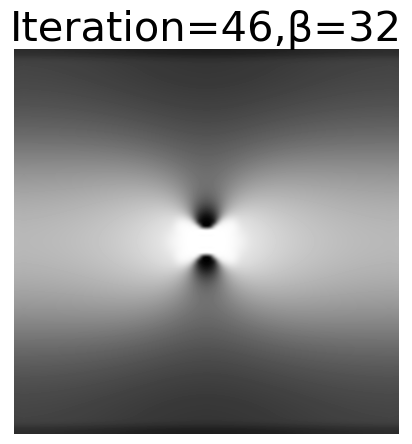

[0.54410523 0.53210895 0.52690761 ... 0.52690761 0.53210895 0.54410523]
2
0.5
32
[0.54450328 0.53249901 0.5273998  ... 0.5273998  0.53249901 0.54450328]


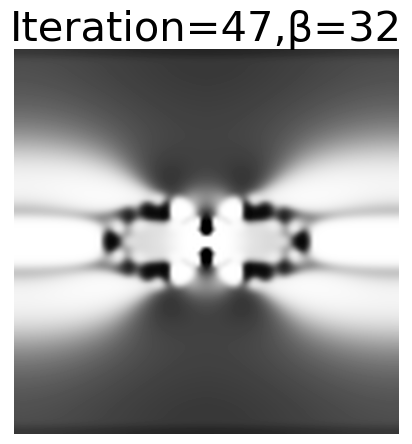

[0.54766995 0.53543137 0.53074438 ... 0.53074438 0.53543137 0.54766995]
2
0.5
32
[0.54450328 0.53249901 0.5273998  ... 0.5273998  0.53249901 0.54450328]


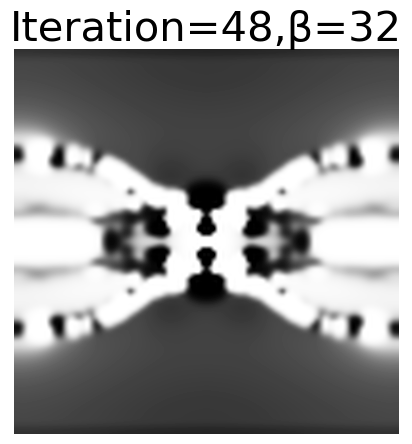

[0.54846367 0.53616835 0.53158938 ... 0.53158938 0.53616835 0.54846367]
2
0.5
32
[0.54450328 0.53249901 0.5273998  ... 0.5273998  0.53249901 0.54450328]


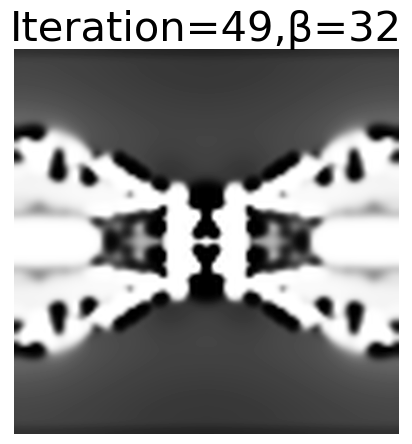

[0.54781204 0.53556328 0.53089568 ... 0.53089568 0.53556328 0.54781204]
2
0.5
32
[0.54450328 0.53249901 0.5273998  ... 0.5273998  0.53249901 0.54450328]


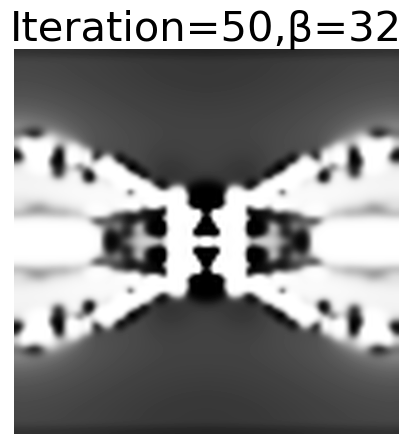

[0.54787901 0.53562536 0.53096667 ... 0.53096667 0.53562536 0.54787901]
2
0.5
32
[0.54450328 0.53249901 0.5273998  ... 0.5273998  0.53249901 0.54450328]


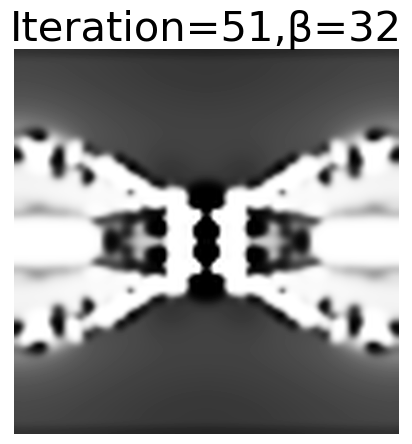

[0.54782172 0.53557225 0.53090594 ... 0.53090594 0.53557225 0.54782172]
2
0.5
32
[0.54450328 0.53249901 0.5273998  ... 0.5273998  0.53249901 0.54450328]


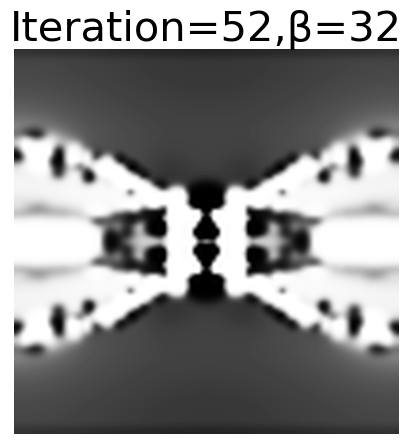

[0.54781442 0.53556549 0.5308982  ... 0.5308982  0.53556549 0.54781442]
2
0.5
32
[0.54450328 0.53249901 0.5273998  ... 0.5273998  0.53249901 0.54450328]


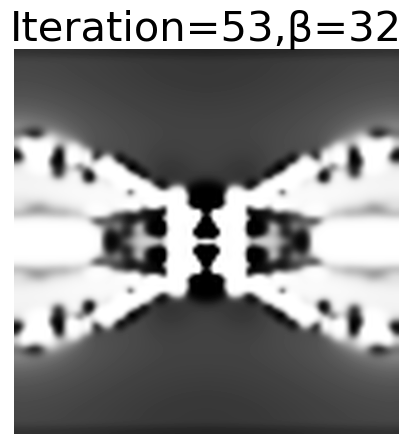

[0.54781287 0.53556405 0.53089656 ... 0.53089656 0.53556405 0.54781287]
2
0.5
32
[0.54450328 0.53249901 0.5273998  ... 0.5273998  0.53249901 0.54450328]


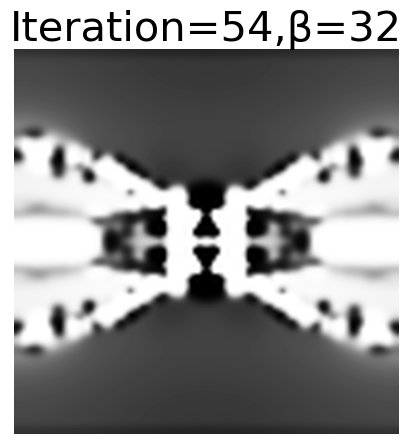

[0.54781237 0.53556359 0.53089603 ... 0.53089603 0.53556359 0.54781237]
2
0.5
32
[0.54450328 0.53249901 0.5273998  ... 0.5273998  0.53249901 0.54450328]


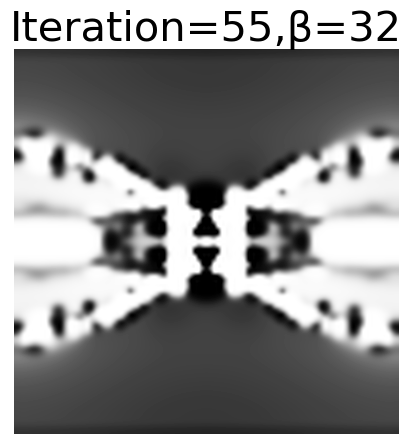

[0.5478124  0.53556361 0.53089606 ... 0.53089606 0.53556361 0.5478124 ]
2
0.5
32
[0.54450328 0.53249901 0.5273998  ... 0.5273998  0.53249901 0.54450328]


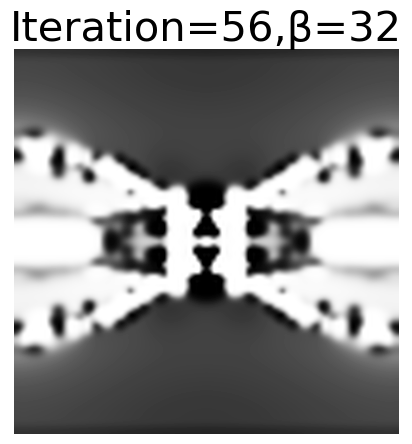

[0.54781239 0.5355636  0.53089604 ... 0.53089604 0.5355636  0.54781239]
2
0.5
32
[0.54450328 0.53249901 0.5273998  ... 0.5273998  0.53249901 0.54450328]


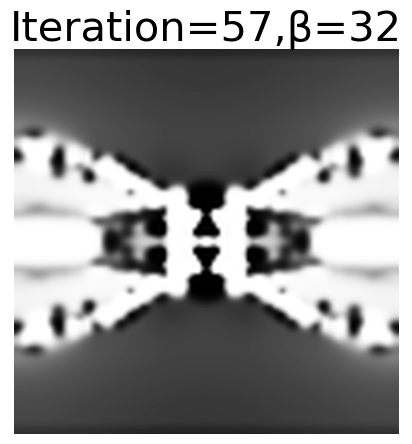

[0.54781238 0.53556359 0.53089604 ... 0.53089604 0.53556359 0.54781238]
2
0.5
32
[0.54450328 0.53249901 0.5273998  ... 0.5273998  0.53249901 0.54450328]


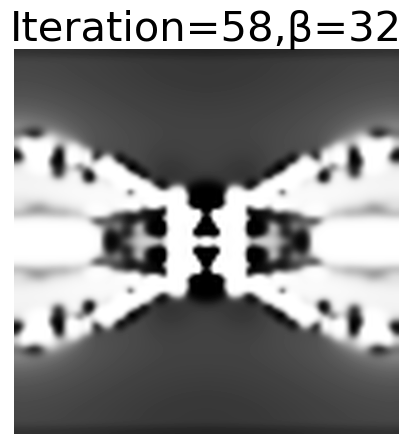

[0.54781238 0.53556359 0.53089603 ... 0.53089603 0.53556359 0.54781238]
2
0.5
32
[0.54450328 0.53249901 0.5273998  ... 0.5273998  0.53249901 0.54450328]


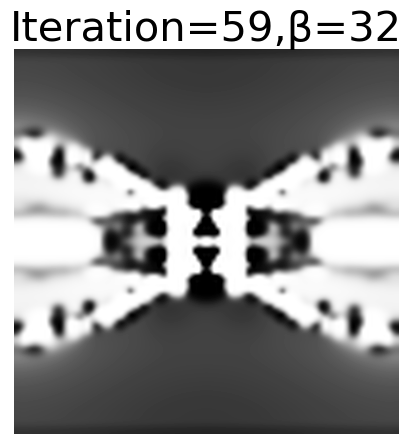

[0.54781237 0.53556359 0.53089603 ... 0.53089603 0.53556359 0.54781237]
2
0.5
32
[0.54450328 0.53249901 0.5273998  ... 0.5273998  0.53249901 0.54450328]


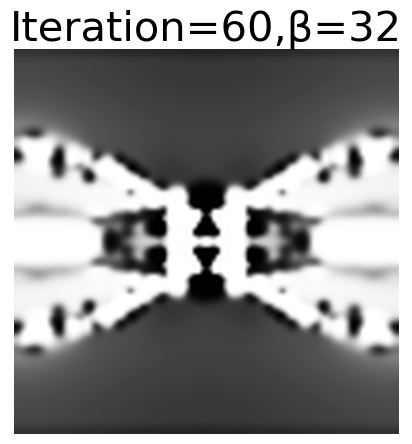

[0.54781237 0.53556359 0.53089603 ... 0.53089603 0.53556359 0.54781237]
2
0.5
64
[0.54781237 0.53556359 0.53089603 ... 0.53089603 0.53556359 0.54781237]


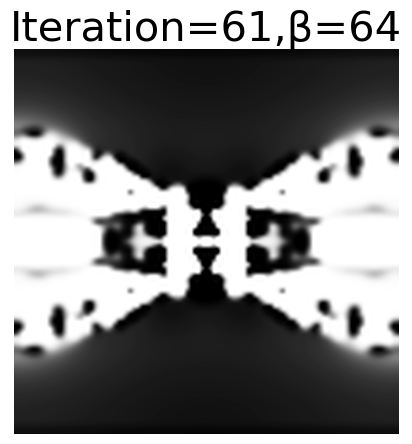

[0.55352367 0.54286932 0.54167851 ... 0.54167851 0.54286932 0.55352367]
2
0.5
64
[0.54781237 0.53556359 0.53089603 ... 0.53089603 0.53556359 0.54781237]


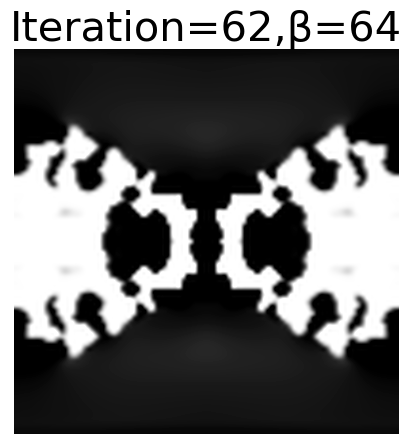

[0.54839542 0.53631373 0.53201729 ... 0.53201729 0.53631373 0.54839542]
2
0.5
64
[0.54781237 0.53556359 0.53089603 ... 0.53089603 0.53556359 0.54781237]


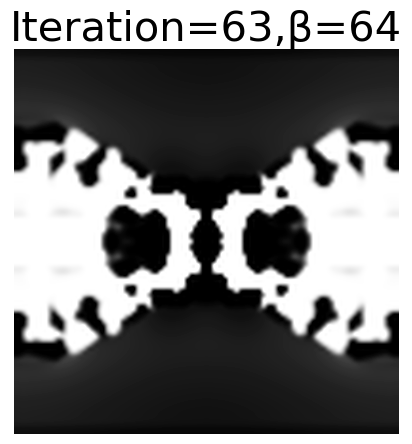

[0.5478708  0.5356388  0.53100861 ... 0.53100861 0.5356388  0.5478708 ]
2
0.5
64
[0.54781237 0.53556359 0.53089603 ... 0.53089603 0.53556359 0.54781237]


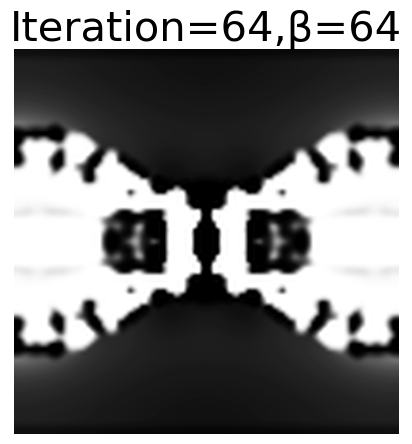

[0.54782109 0.53557481 0.53091283 ... 0.53091283 0.53557481 0.54782109]
2
0.5
64
[0.54781237 0.53556359 0.53089603 ... 0.53089603 0.53556359 0.54781237]


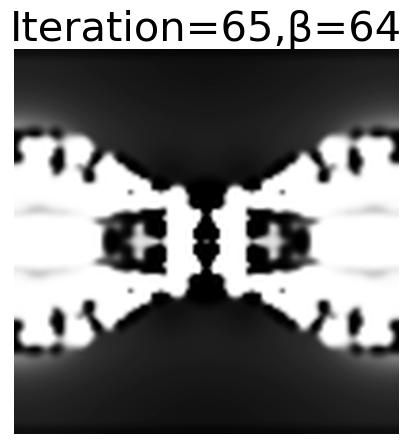

[0.54781463 0.53556649 0.53090037 ... 0.53090037 0.53556649 0.54781463]
2
0.5
64
[0.54781237 0.53556359 0.53089603 ... 0.53089603 0.53556359 0.54781237]


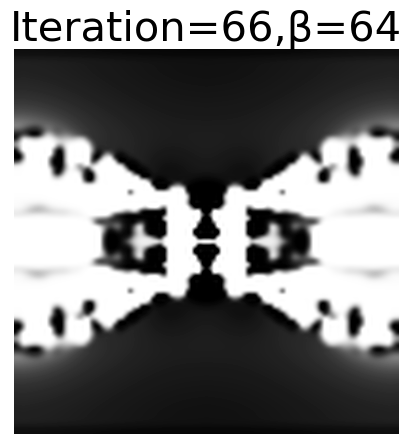

[0.54781315 0.53556458 0.53089752 ... 0.53089752 0.53556458 0.54781315]
2
0.5
64
[0.54781237 0.53556359 0.53089603 ... 0.53089603 0.53556359 0.54781237]


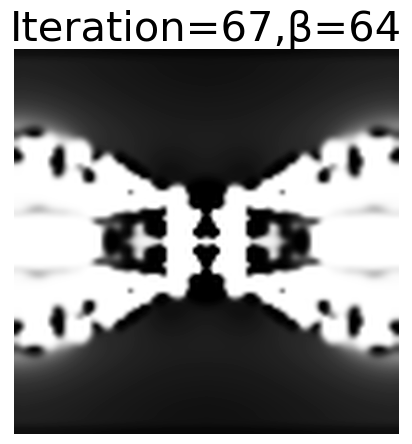

[0.54781268 0.53556398 0.53089662 ... 0.53089662 0.53556398 0.54781268]
2
0.5
64
[0.54781237 0.53556359 0.53089603 ... 0.53089603 0.53556359 0.54781237]


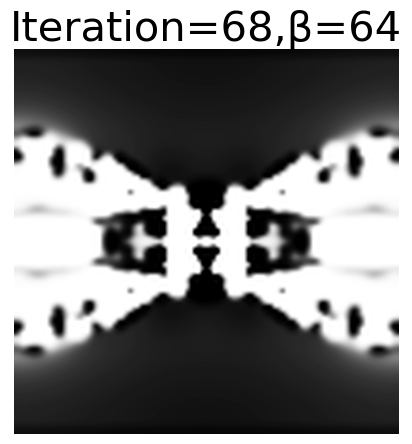

[0.5478125  0.53556375 0.53089628 ... 0.53089628 0.53556375 0.5478125 ]
2
0.5
64
[0.54781237 0.53556359 0.53089603 ... 0.53089603 0.53556359 0.54781237]


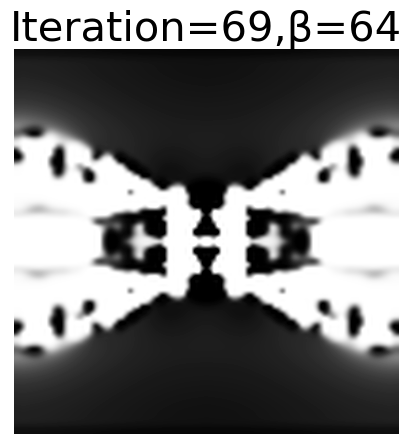

[0.54781256 0.53556382 0.53089638 ... 0.53089638 0.53556382 0.54781256]
2
0.5
64
[0.54781237 0.53556359 0.53089603 ... 0.53089603 0.53556359 0.54781237]


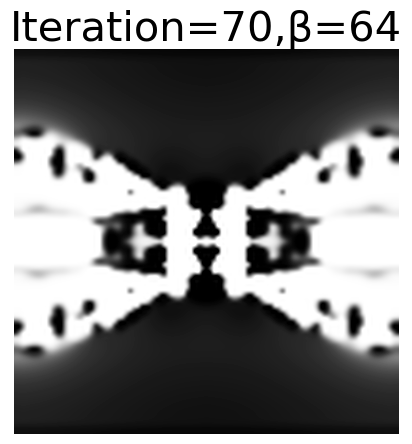

[0.54781253 0.53556378 0.53089632 ... 0.53089632 0.53556378 0.54781253]
2
0.5
64
[0.54781237 0.53556359 0.53089603 ... 0.53089603 0.53556359 0.54781237]


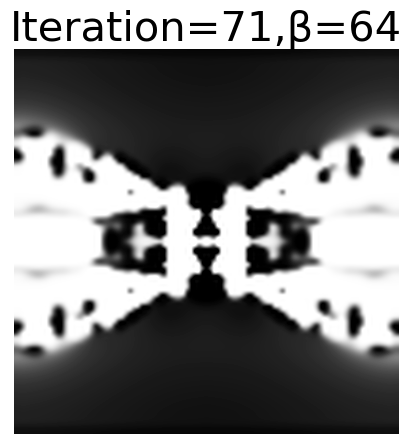

[0.54781251 0.53556377 0.5308963  ... 0.5308963  0.53556377 0.54781251]
2
0.5
64
[0.54781237 0.53556359 0.53089603 ... 0.53089603 0.53556359 0.54781237]


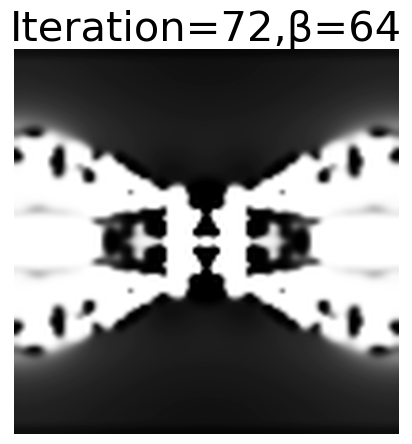

[0.54781252 0.53556377 0.53089631 ... 0.53089631 0.53556377 0.54781252]
2
0.5
64
[0.54781237 0.53556359 0.53089603 ... 0.53089603 0.53556359 0.54781237]


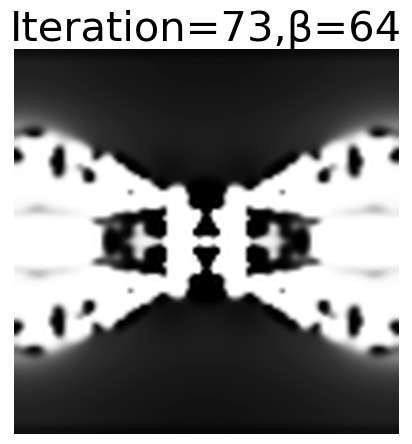

[0.54781252 0.53556378 0.53089632 ... 0.53089632 0.53556378 0.54781252]
2
0.5
64
[0.54781237 0.53556359 0.53089603 ... 0.53089603 0.53556359 0.54781237]


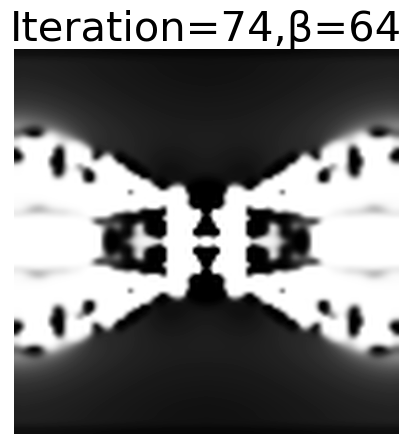

[0.54781253 0.53556378 0.53089633 ... 0.53089633 0.53556378 0.54781253]
2
0.5
64
[0.54781237 0.53556359 0.53089603 ... 0.53089603 0.53556359 0.54781237]


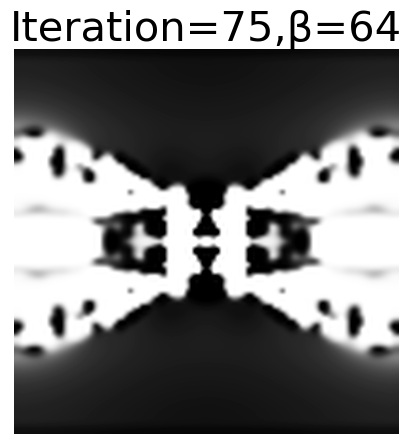

[0.54781253 0.53556378 0.53089633 ... 0.53089633 0.53556378 0.54781253]
2
0.5
128
[0.54781253 0.53556378 0.53089633 ... 0.53089633 0.53556378 0.54781253]


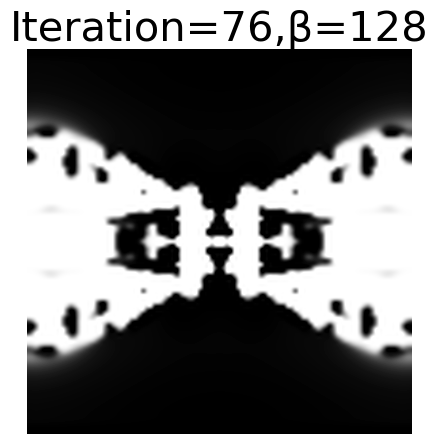

[0.54789017 0.53576772 0.53134844 ... 0.53134844 0.53576772 0.54789017]
2
0.5
128
[0.54781253 0.53556378 0.53089633 ... 0.53089633 0.53556378 0.54781253]


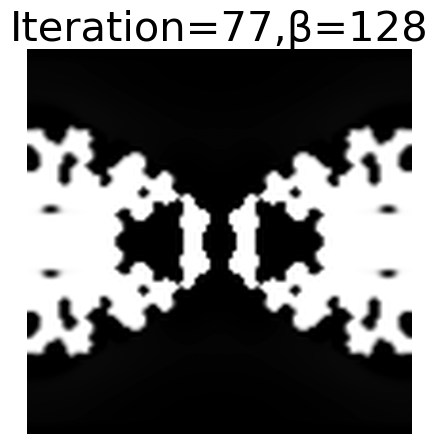

[0.54782029 0.53558419 0.53094161 ... 0.53094161 0.53558419 0.54782029]
2
0.5
128
[0.54781253 0.53556378 0.53089633 ... 0.53089633 0.53556378 0.54781253]


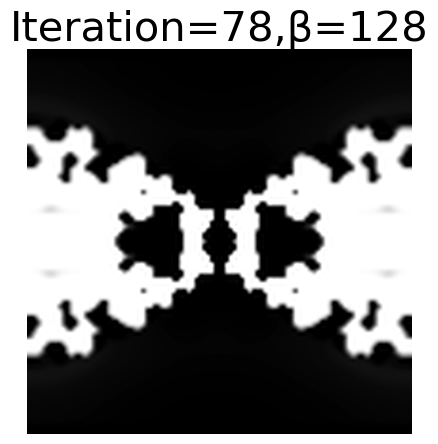

[0.5478133  0.53556582 0.53090086 ... 0.53090086 0.53556582 0.5478133 ]
2
0.5
128
[0.54781253 0.53556378 0.53089633 ... 0.53089633 0.53556378 0.54781253]


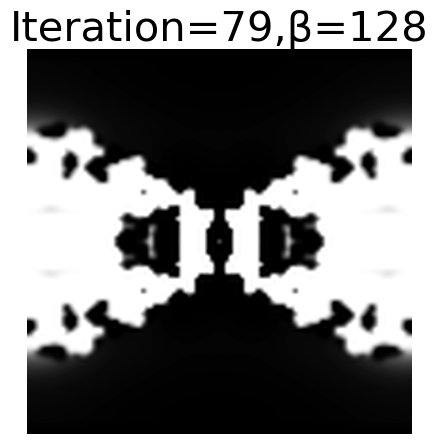

[0.5478126  0.53556399 0.53089678 ... 0.53089678 0.53556399 0.5478126 ]
2
0.5
128
[0.54781253 0.53556378 0.53089633 ... 0.53089633 0.53556378 0.54781253]


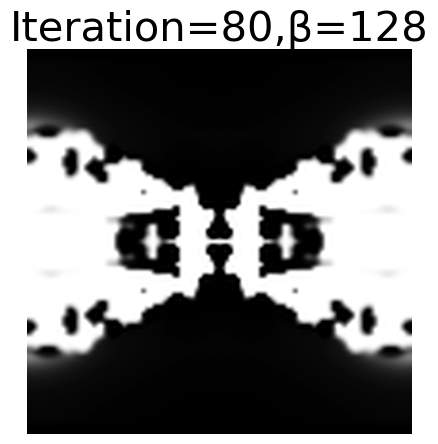

[0.54781254 0.53556382 0.53089641 ... 0.53089641 0.53556382 0.54781254]
2
0.5
128
[0.54781253 0.53556378 0.53089633 ... 0.53089633 0.53556378 0.54781253]


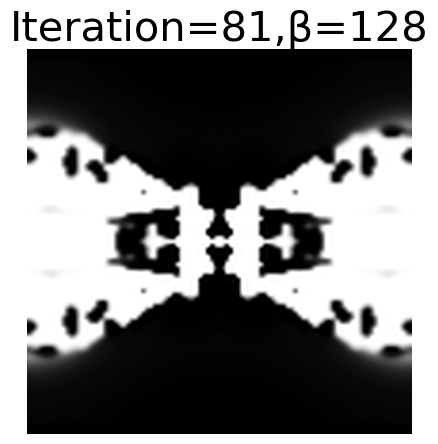

[0.54781253 0.53556379 0.53089635 ... 0.53089635 0.53556379 0.54781253]
2
0.5
128
[0.54781253 0.53556378 0.53089633 ... 0.53089633 0.53556378 0.54781253]


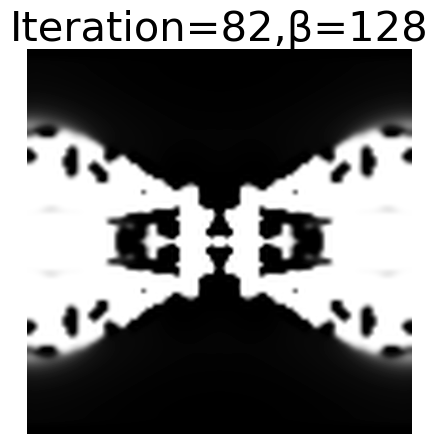

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
128
[0.54781253 0.53556378 0.53089633 ... 0.53089633 0.53556378 0.54781253]


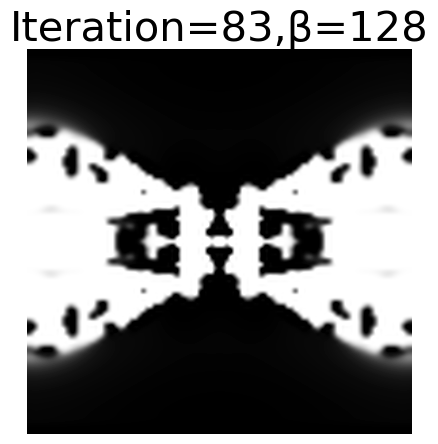

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
128
[0.54781253 0.53556378 0.53089633 ... 0.53089633 0.53556378 0.54781253]


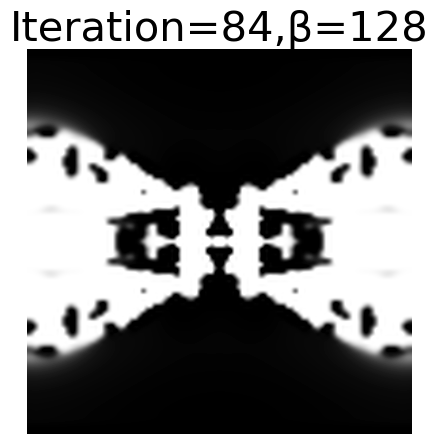

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
128
[0.54781253 0.53556378 0.53089633 ... 0.53089633 0.53556378 0.54781253]


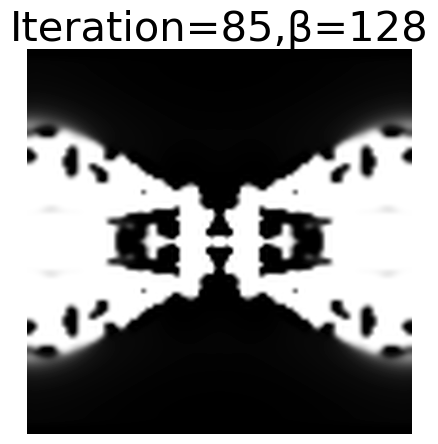

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
128
[0.54781253 0.53556378 0.53089633 ... 0.53089633 0.53556378 0.54781253]


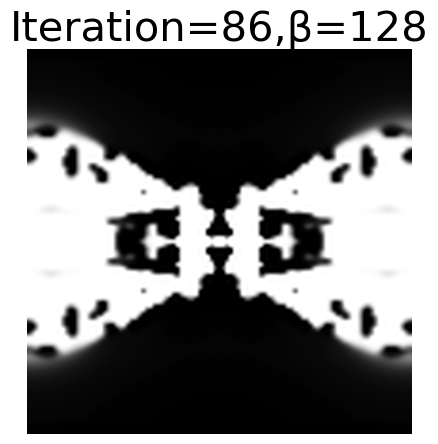

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
128
[0.54781253 0.53556378 0.53089633 ... 0.53089633 0.53556378 0.54781253]


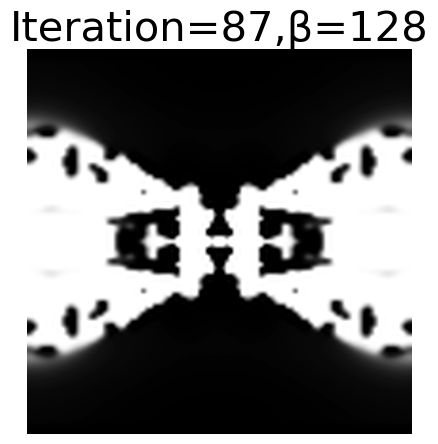

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
128
[0.54781253 0.53556378 0.53089633 ... 0.53089633 0.53556378 0.54781253]


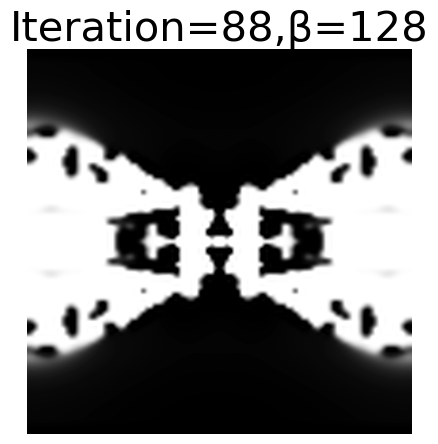

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
128
[0.54781253 0.53556378 0.53089633 ... 0.53089633 0.53556378 0.54781253]


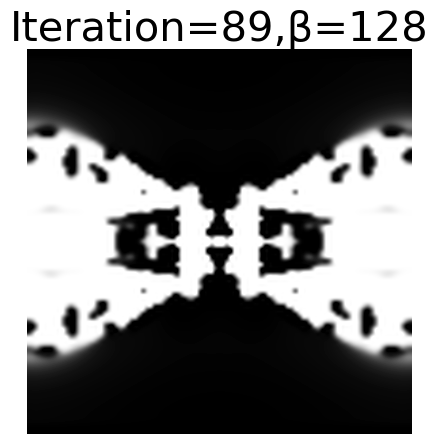

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
128
[0.54781253 0.53556378 0.53089633 ... 0.53089633 0.53556378 0.54781253]


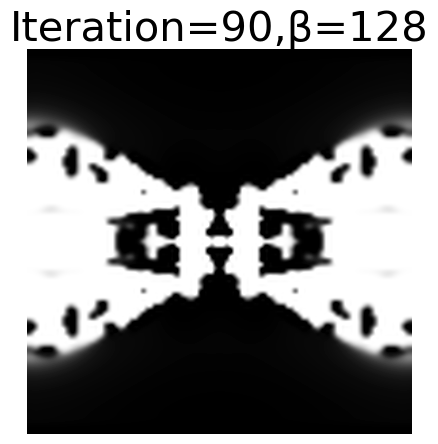

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
256
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


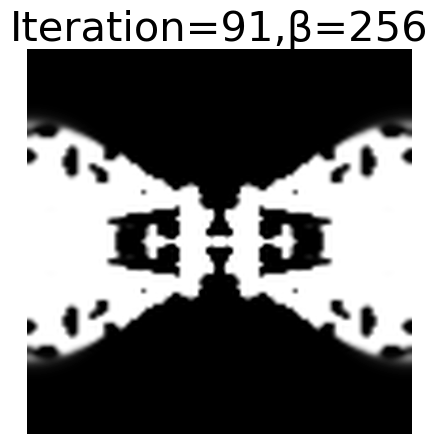

[0.54781254 0.53556389 0.53089668 ... 0.53089668 0.53556389 0.54781254]
2
0.5
256
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


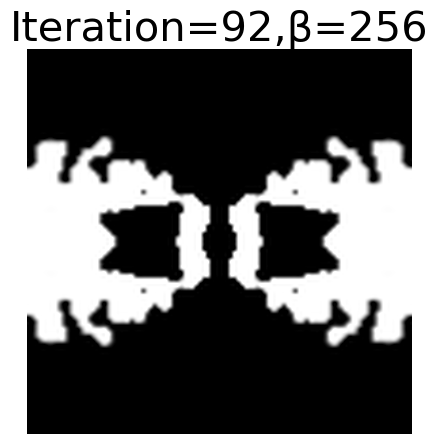

[0.54781253 0.5355638  0.53089637 ... 0.53089637 0.5355638  0.54781253]
2
0.5
256
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


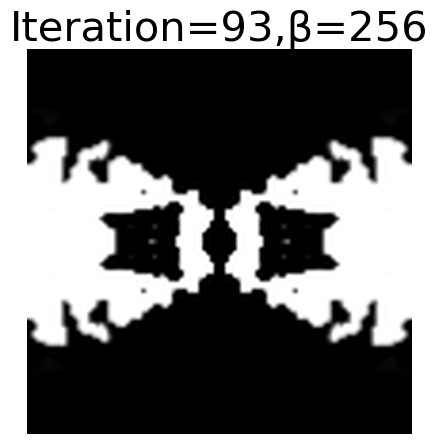

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
256
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


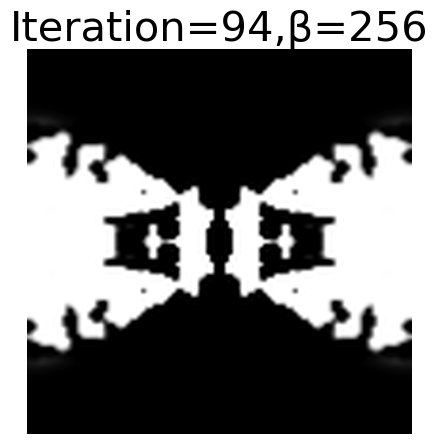

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
256
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


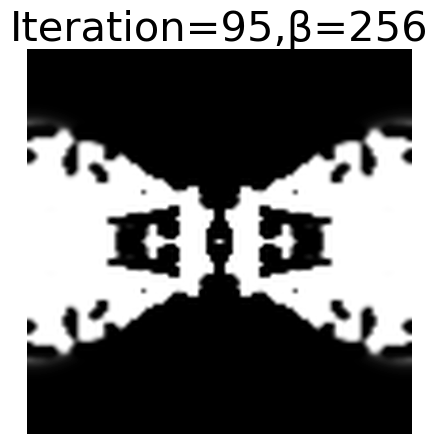

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
256
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


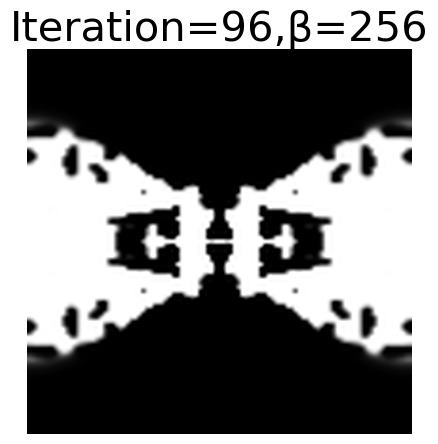

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
256
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


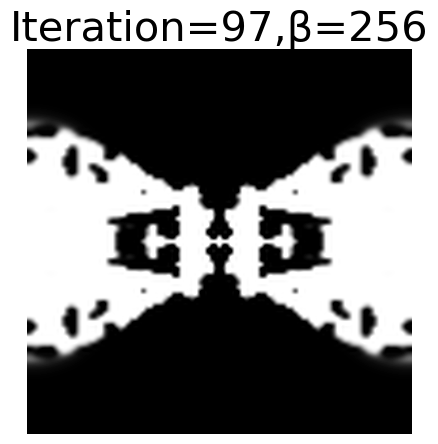

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
256
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


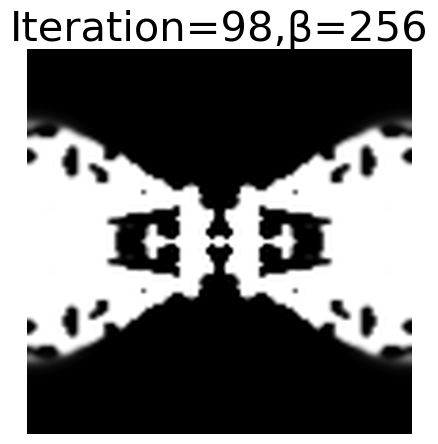

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
256
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


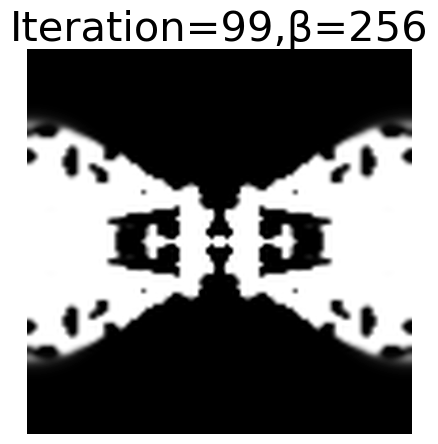

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
256
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


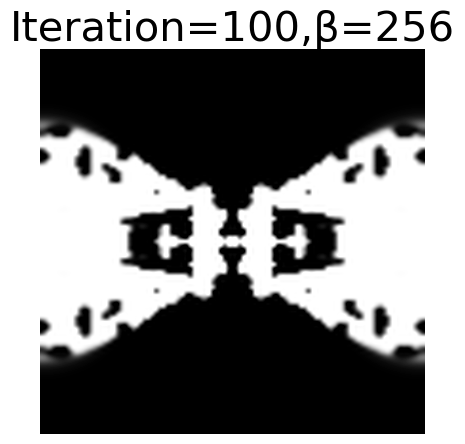

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
256
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


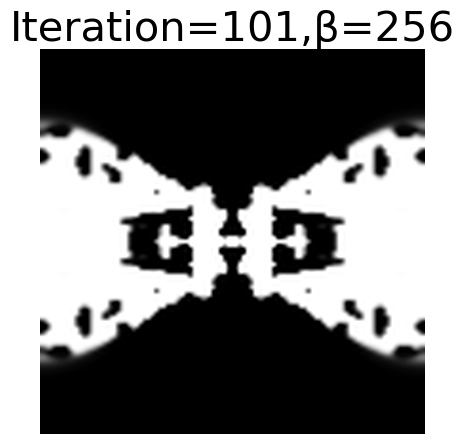

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
256
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


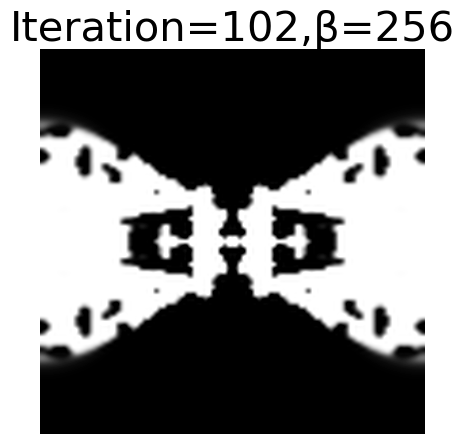

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
256
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


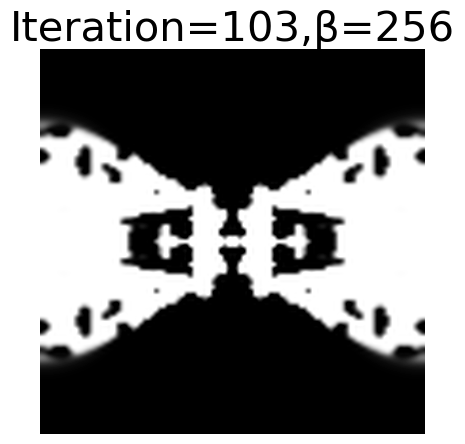

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
256
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


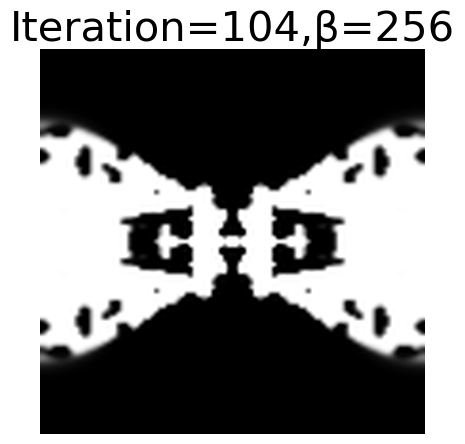

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
256
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


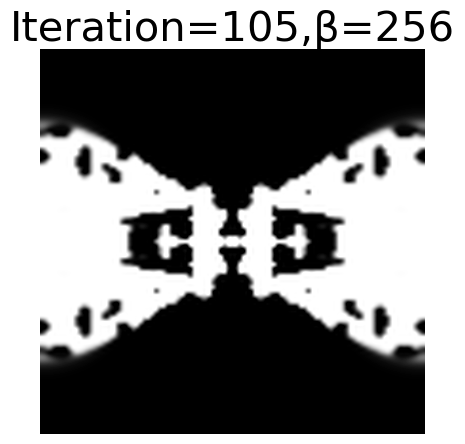

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
512
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


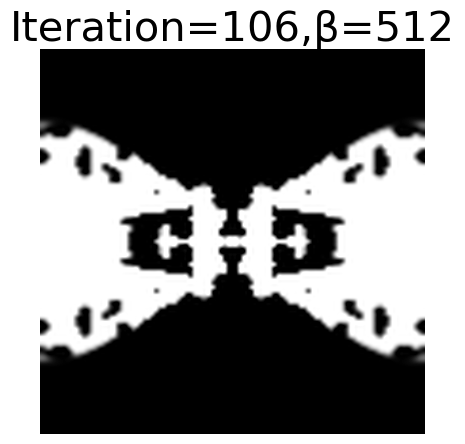

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
512
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


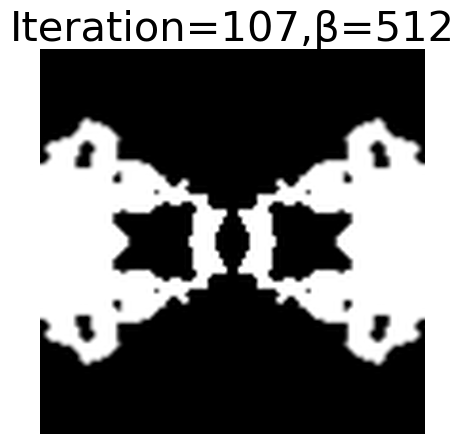

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
512
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


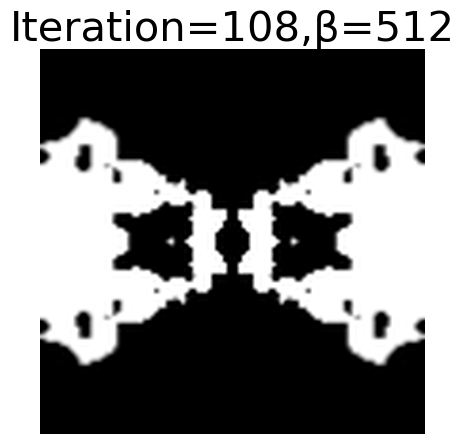

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
512
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


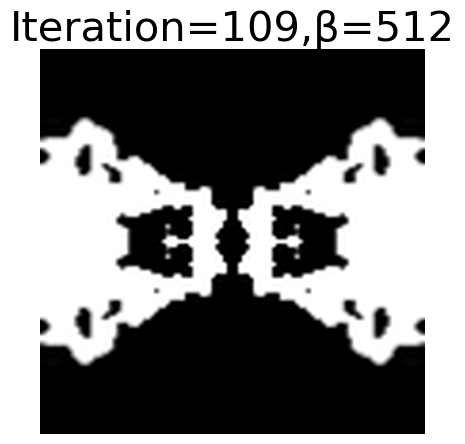

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
512
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


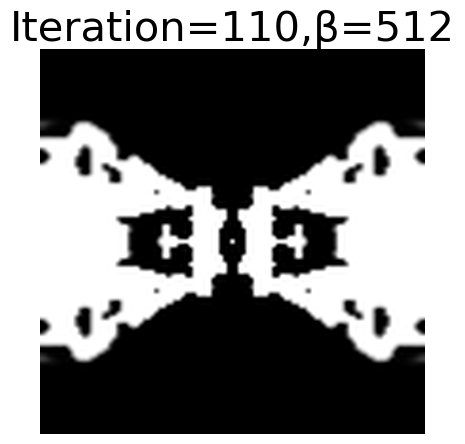

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
512
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


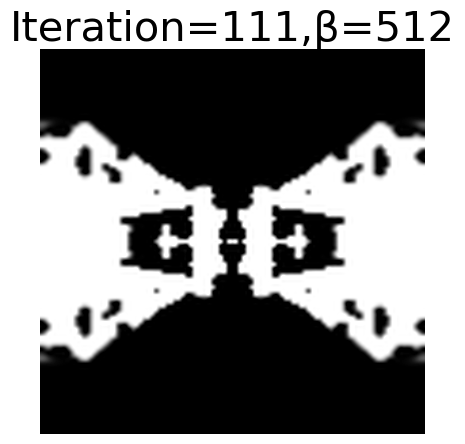

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
512
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


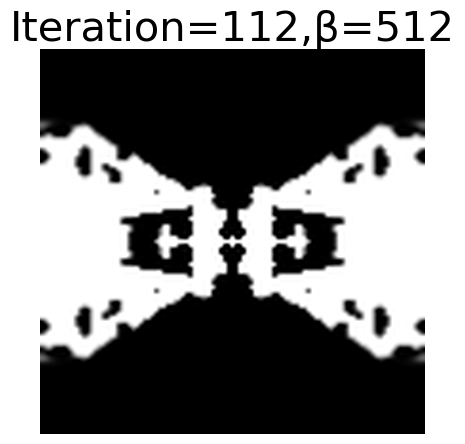

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
512
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


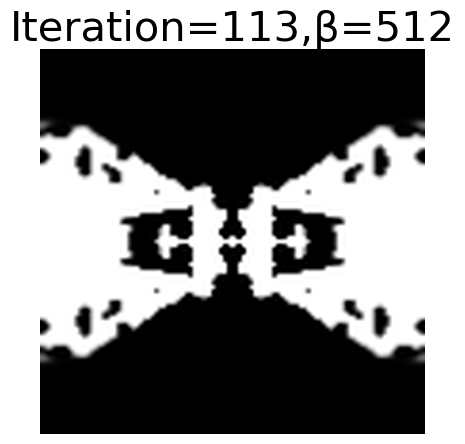

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
512
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


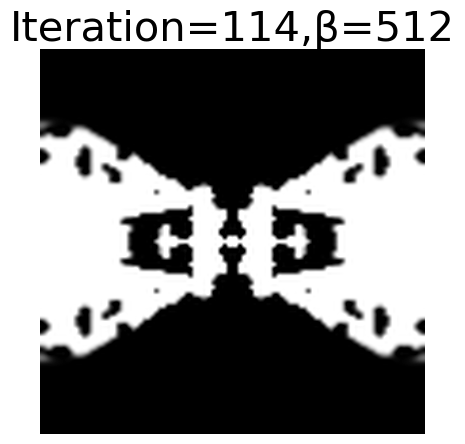

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
512
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


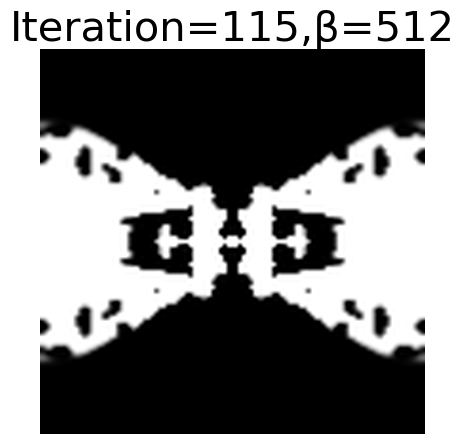

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
512
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


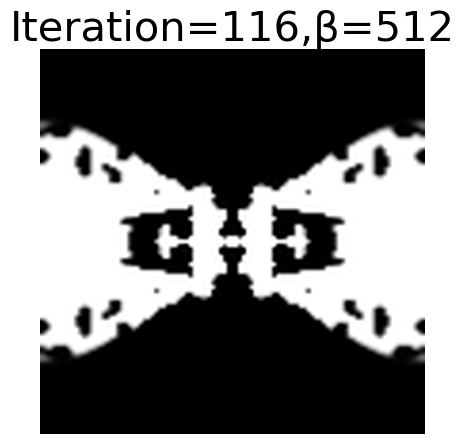

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
512
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


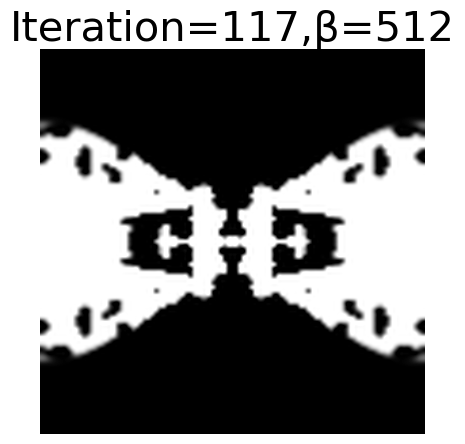

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
512
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


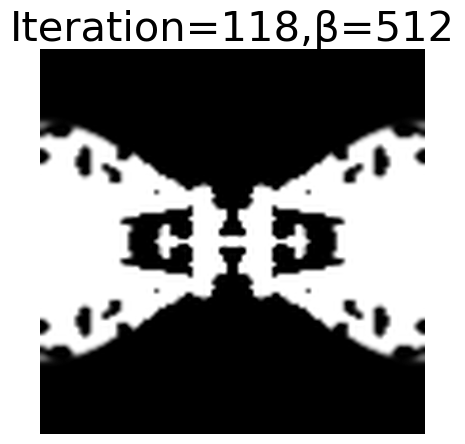

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
512
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


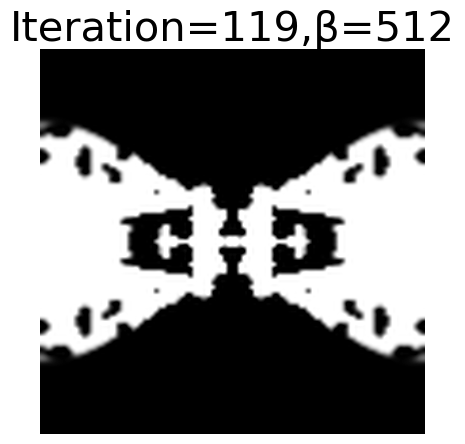

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
512
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


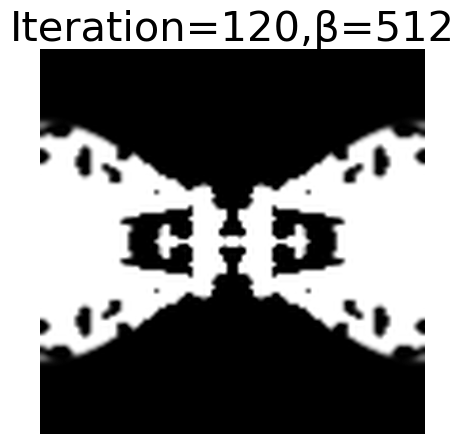

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
1024
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


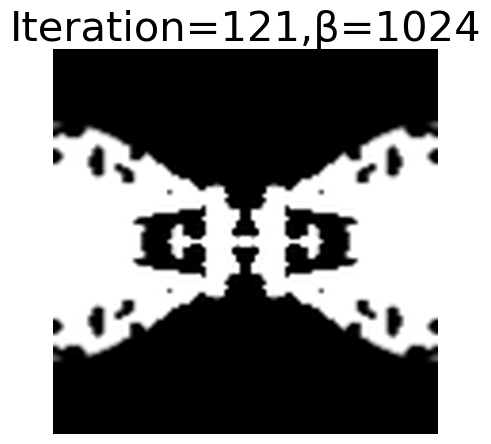

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
1024
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


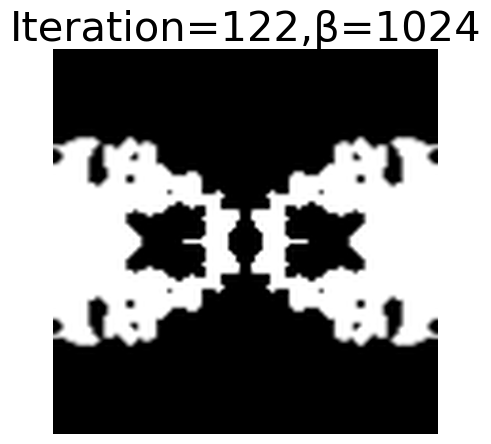

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
1024
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


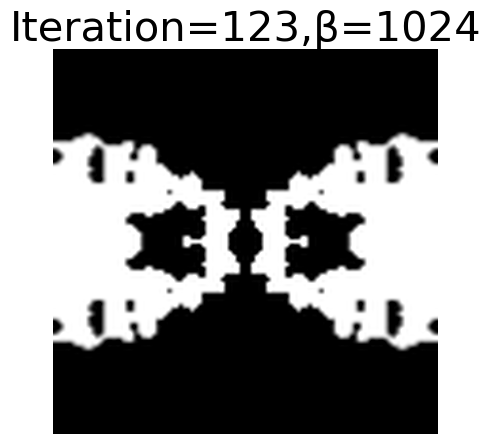

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
1024
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


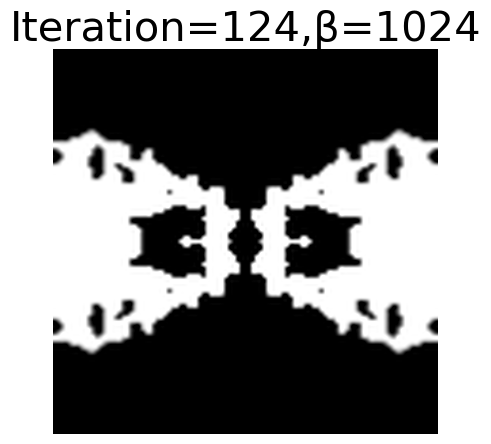

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
1024
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


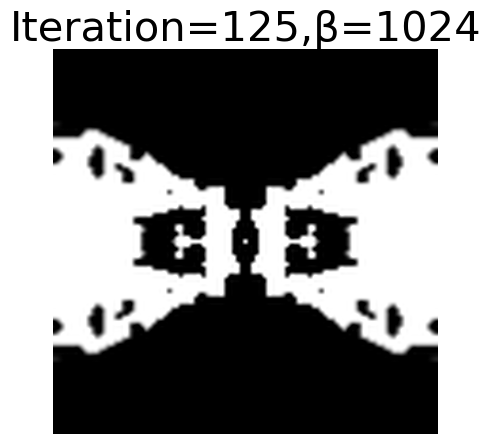

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
1024
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


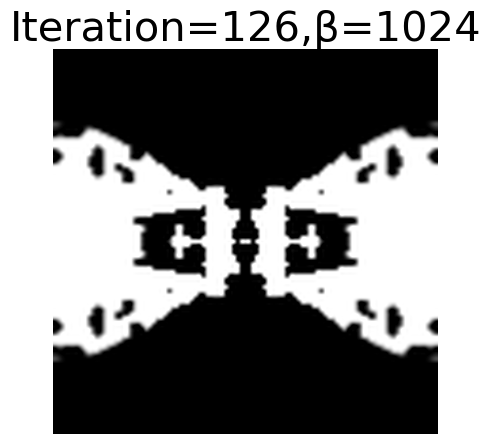

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
1024
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


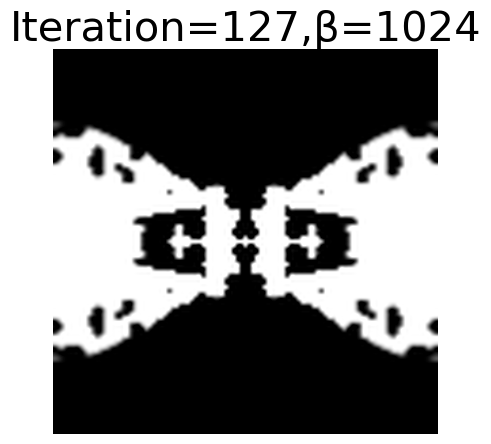

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
1024
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


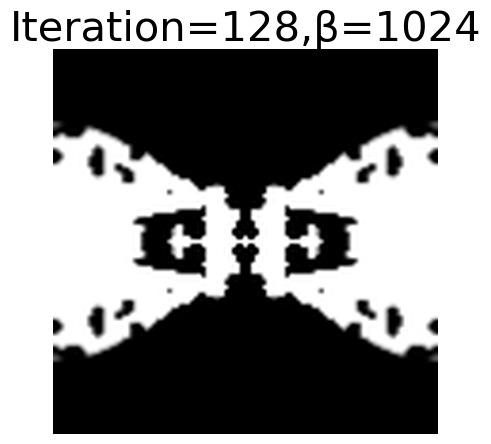

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
1024
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


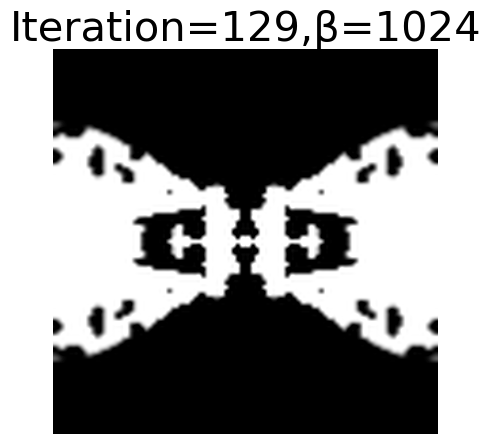

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
1024
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


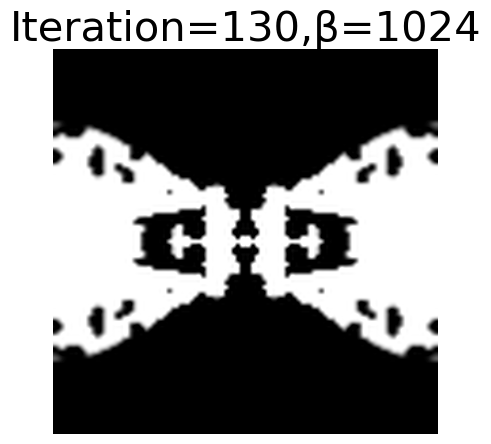

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
1024
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


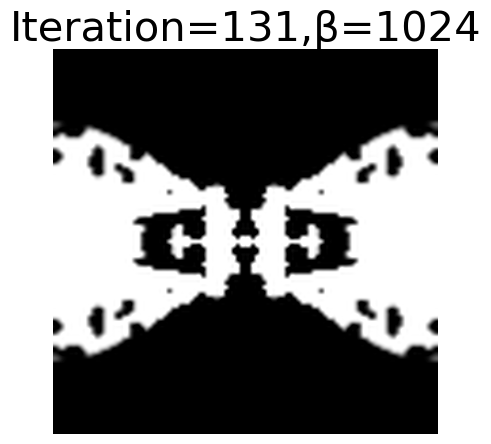

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
1024
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


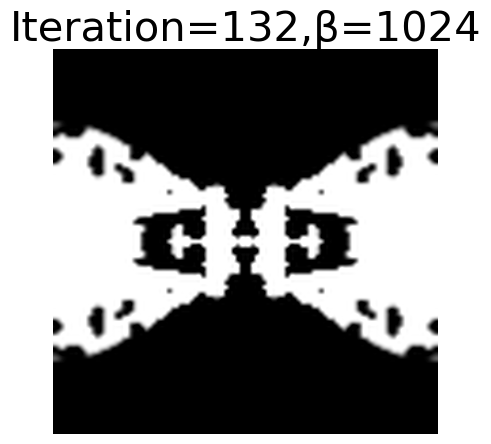

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
1024
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


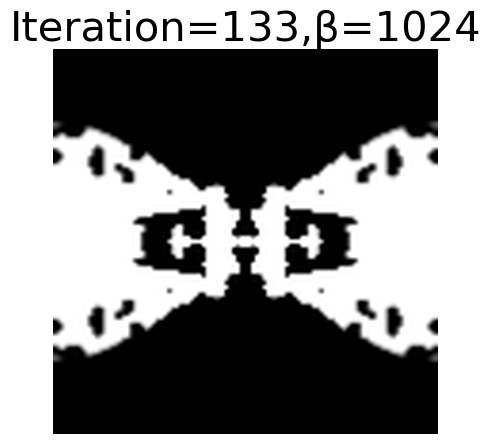

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
1024
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


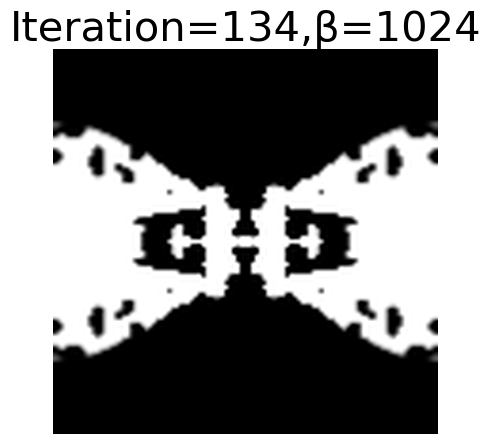

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
1024
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


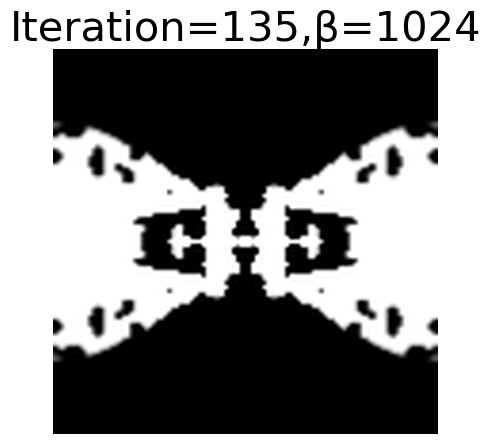

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
2048
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


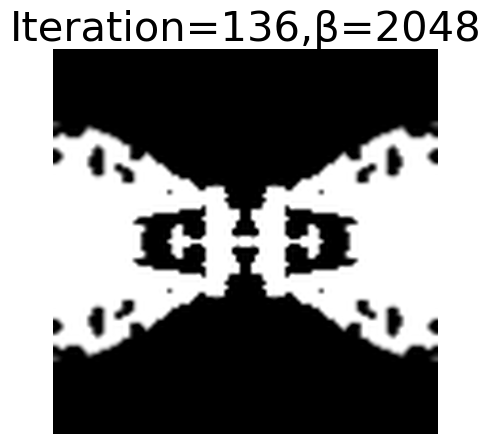

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
2048
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


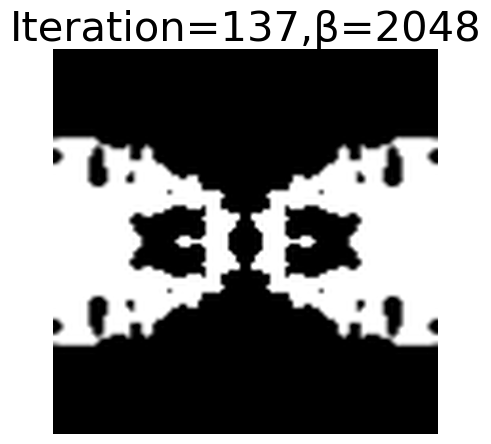

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
2048
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


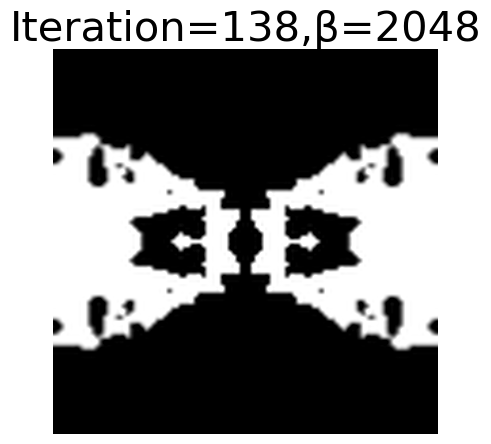

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
2048
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


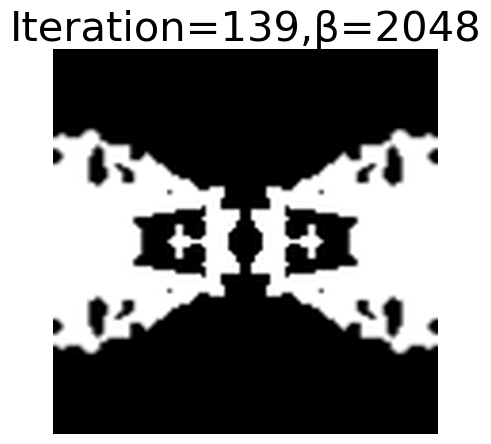

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
2048
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


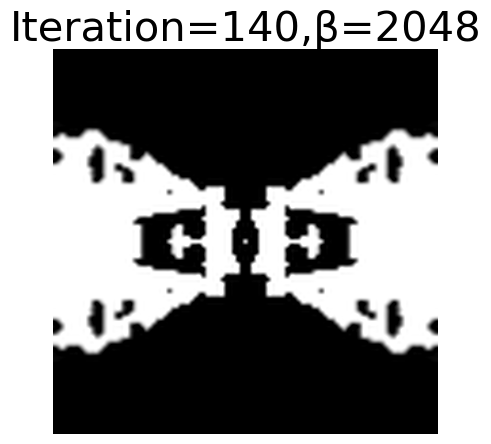

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
2048
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


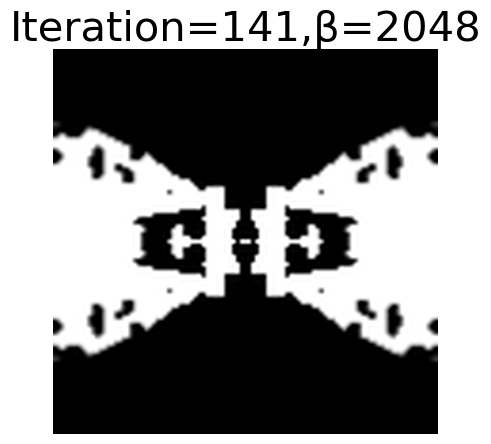

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
2048
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


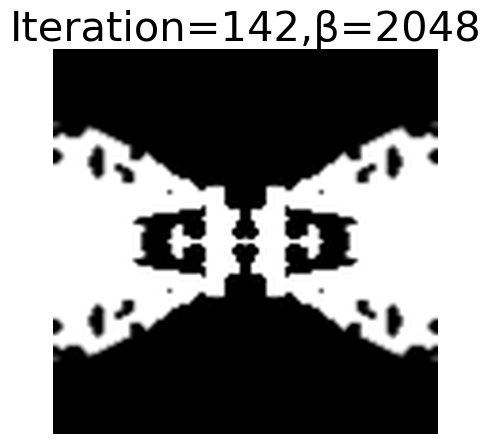

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
2048
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


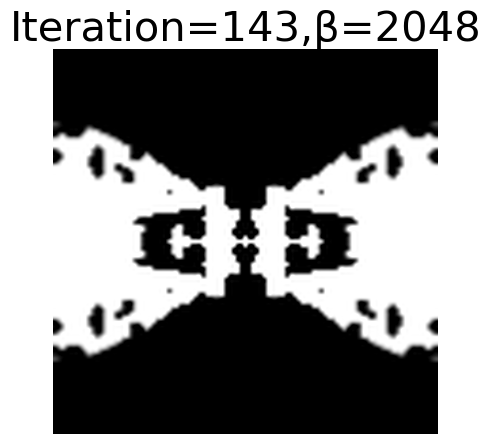

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
2048
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


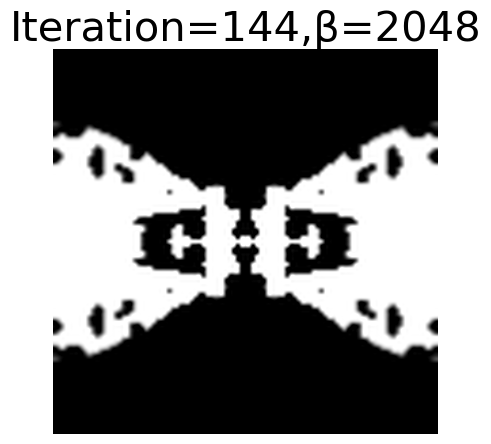

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
2048
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


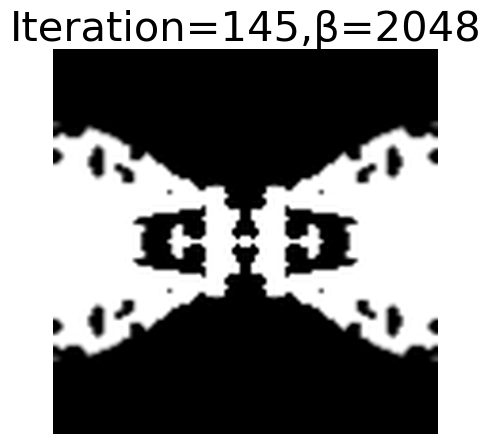

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
2048
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


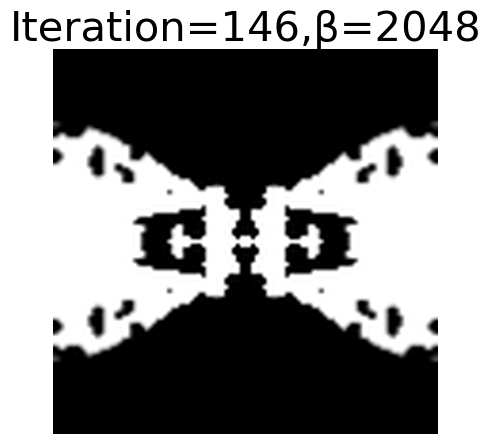

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
2048
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


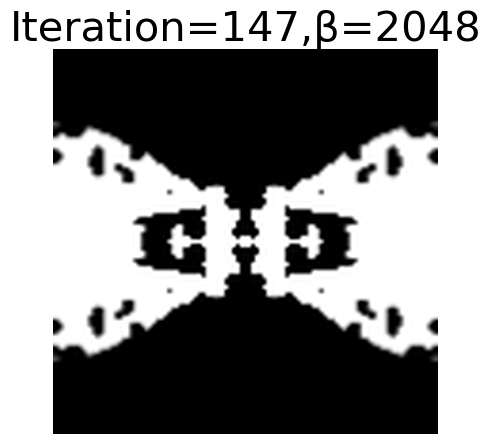

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
2048
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


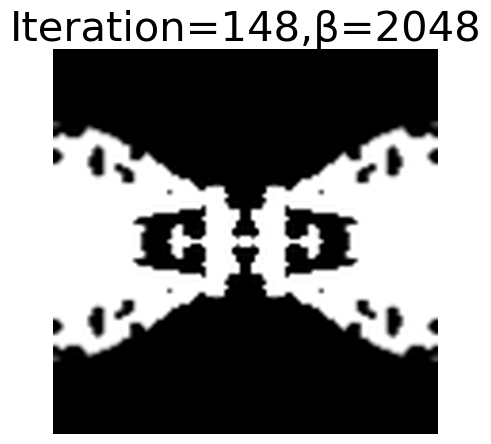

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
2048
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


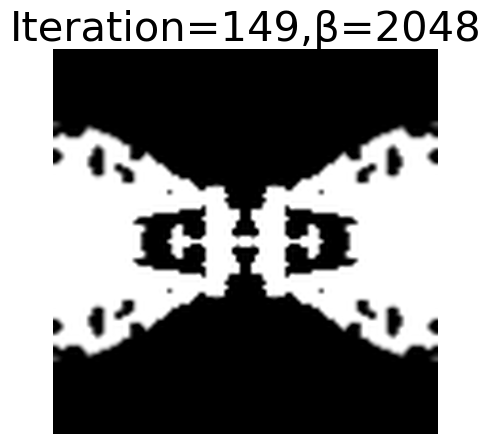

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
2048
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


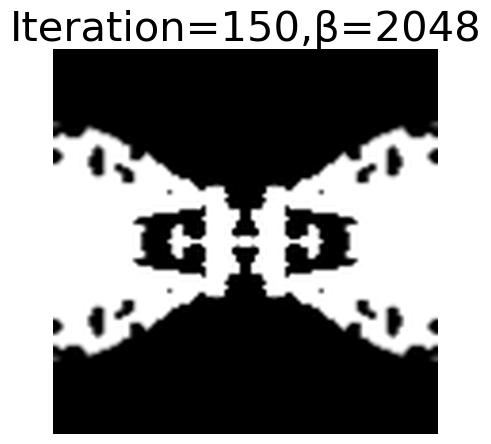

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
4096
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


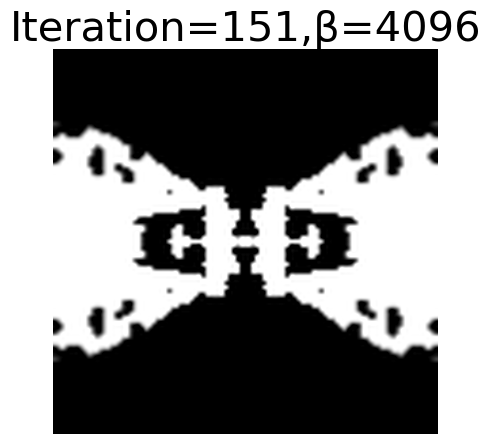

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
4096
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


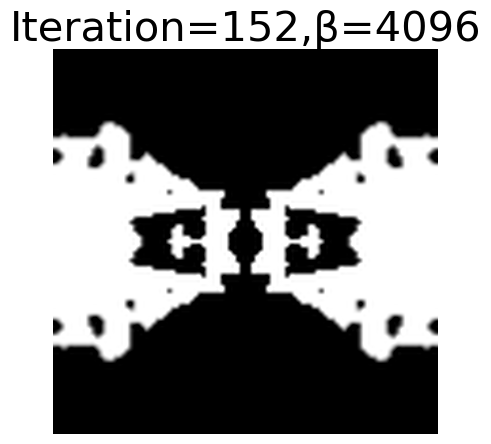

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
4096
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


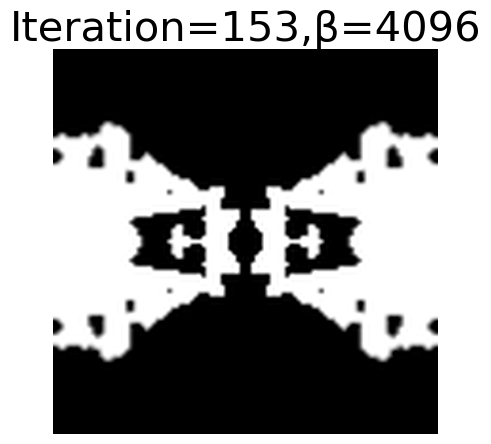

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
4096
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


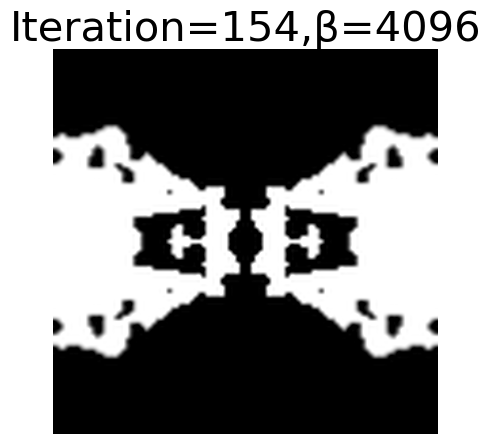

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
4096
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


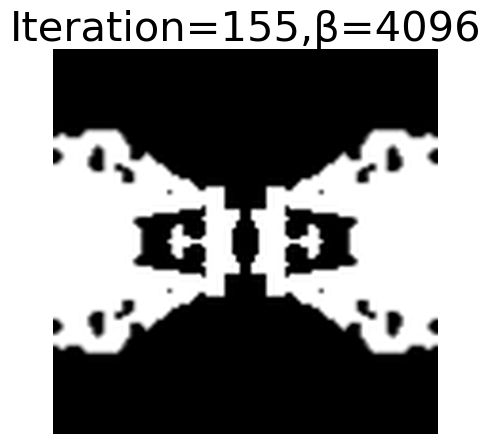

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
4096
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


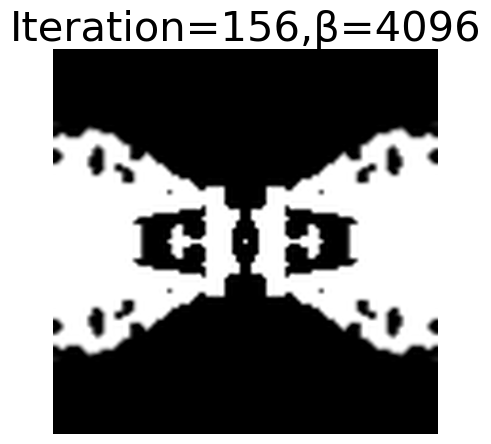

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
4096
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


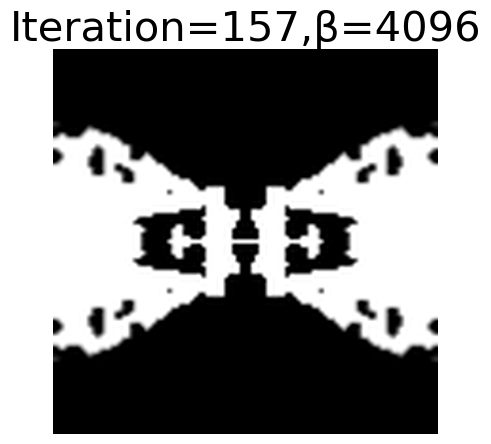

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
4096
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


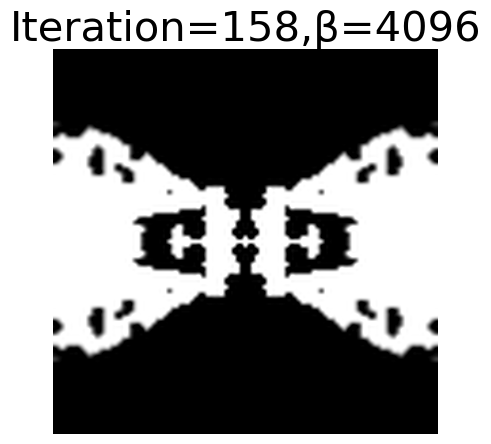

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
4096
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


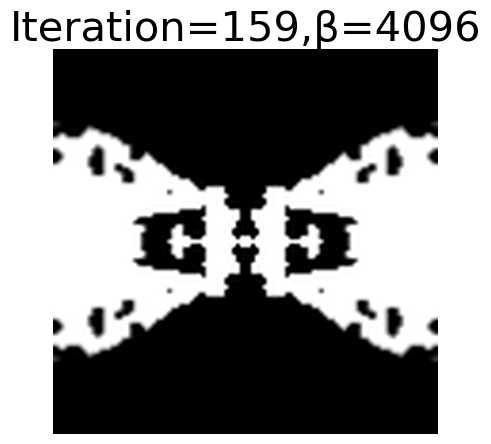

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
4096
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


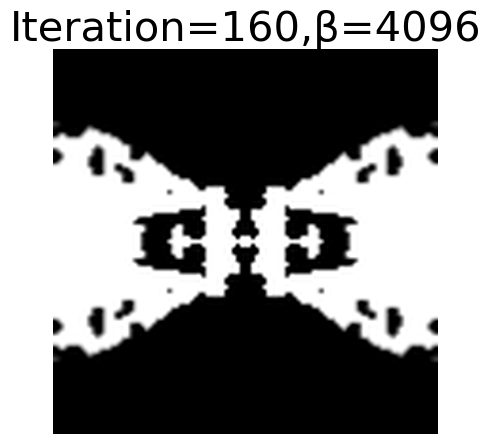

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
4096
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


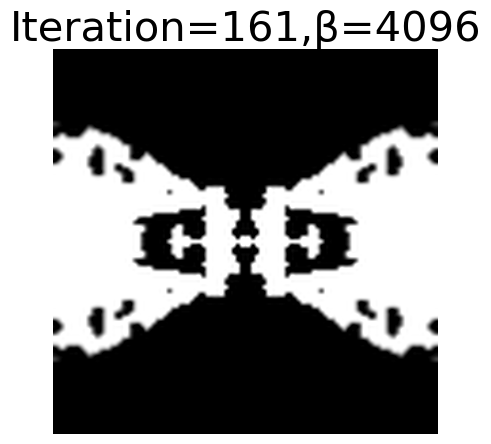

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
4096
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


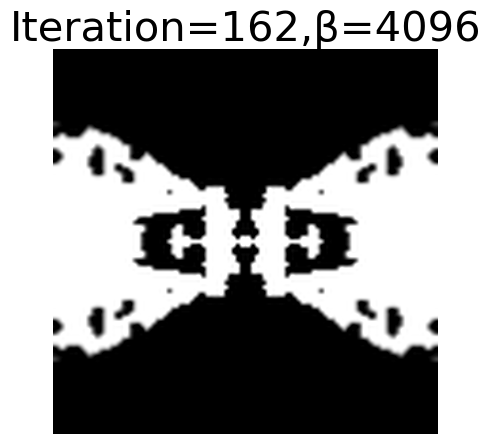

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
4096
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


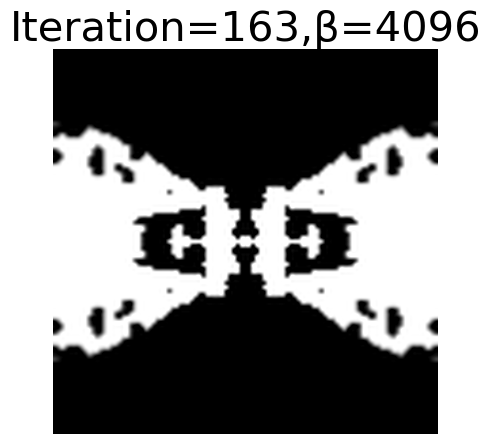

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
4096
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


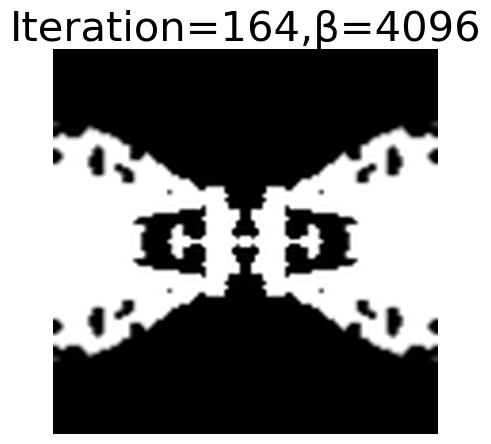

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
4096
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


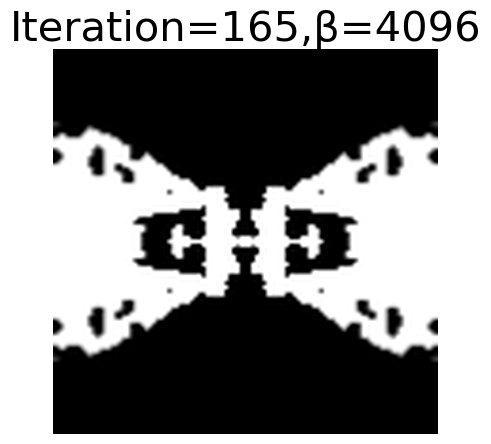

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
8192
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


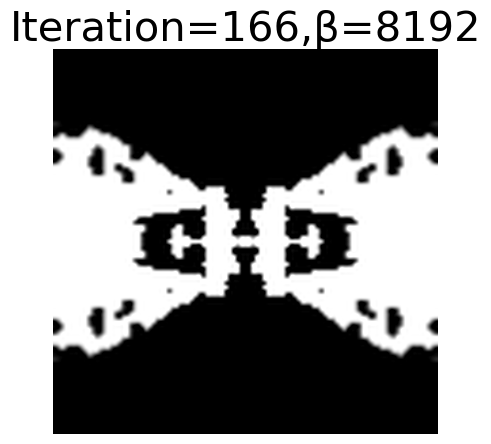

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
8192
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


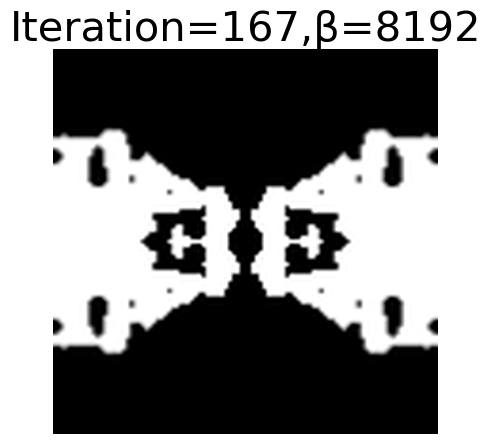

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
8192
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


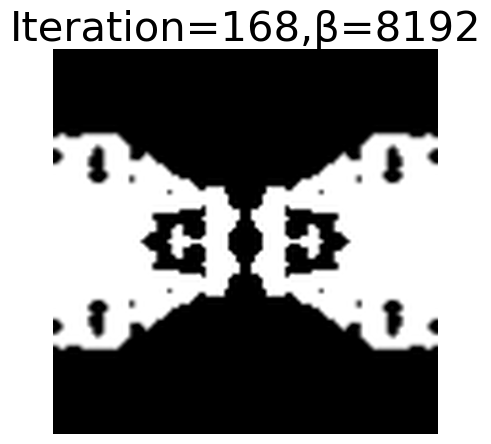

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
8192
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


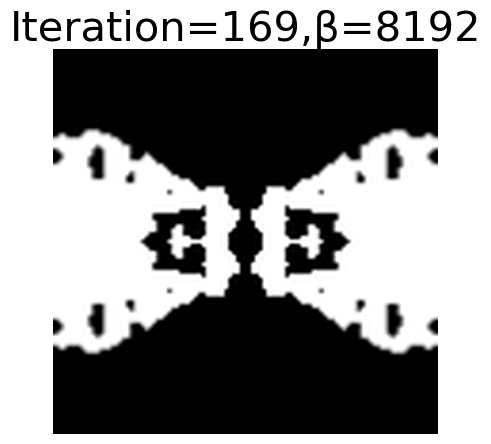

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
8192
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


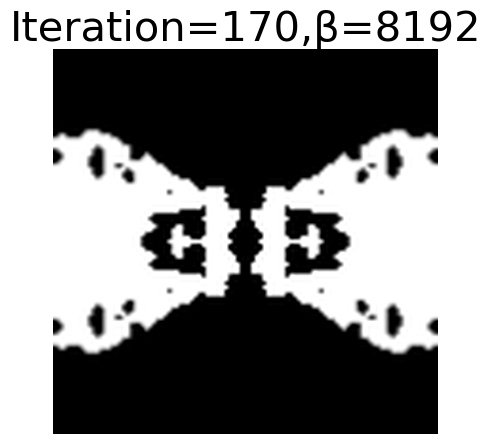

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
8192
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


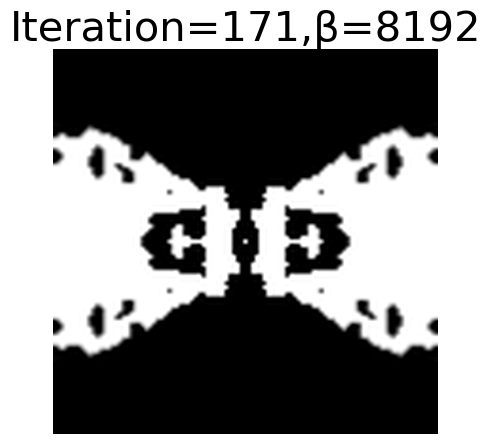

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
8192
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


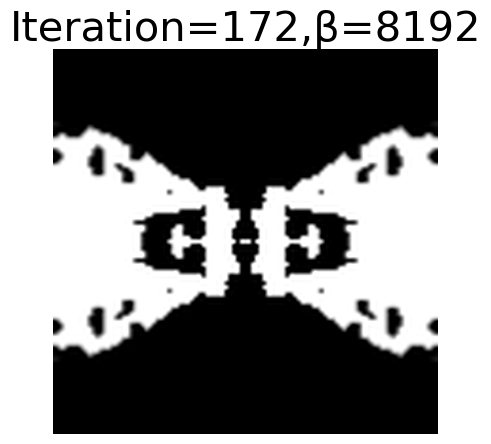

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
8192
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


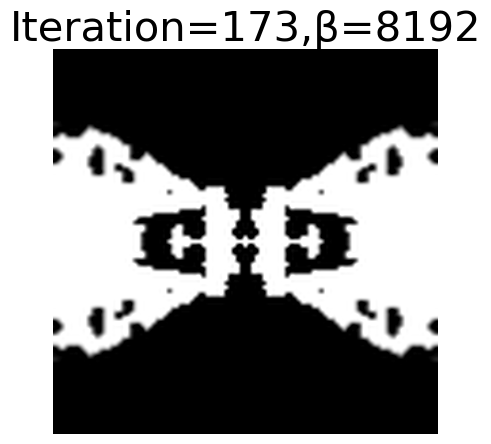

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
8192
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


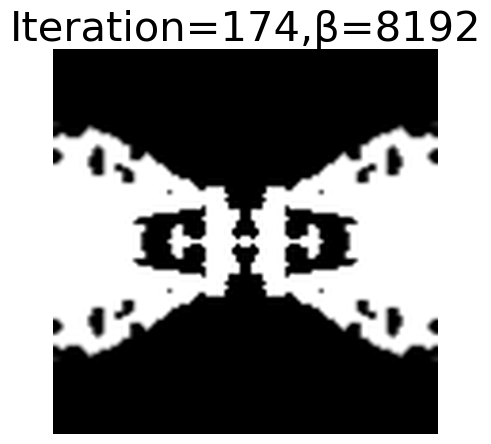

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
8192
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


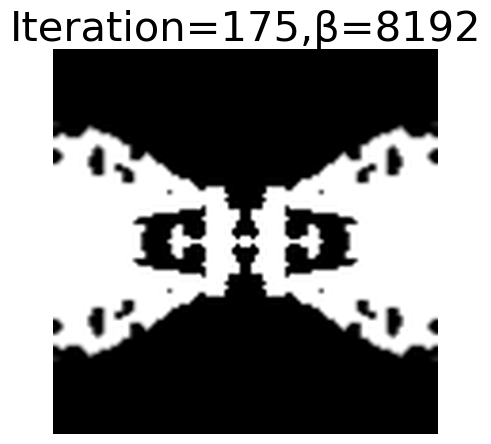

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
8192
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


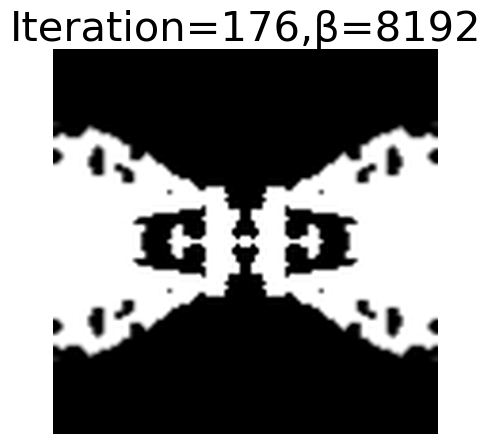

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
8192
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


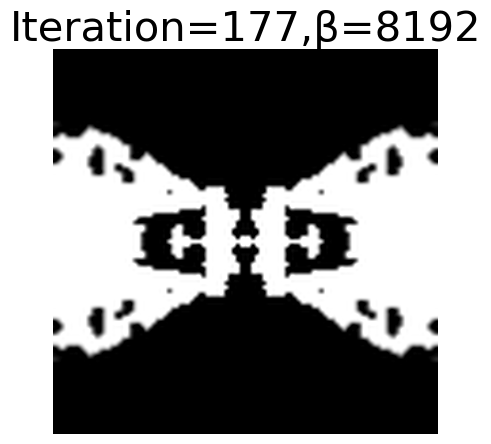

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
8192
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


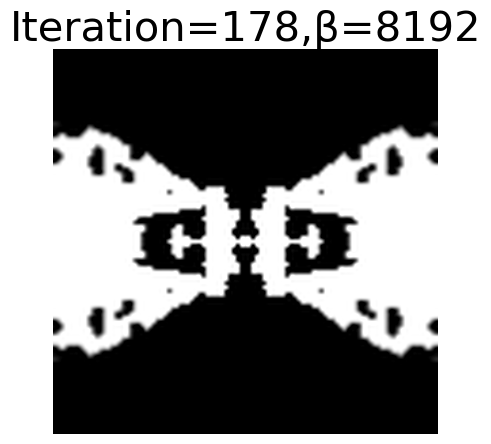

[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]
2
0.5
8192
[0.54781253 0.53556379 0.53089634 ... 0.53089634 0.53556379 0.54781253]


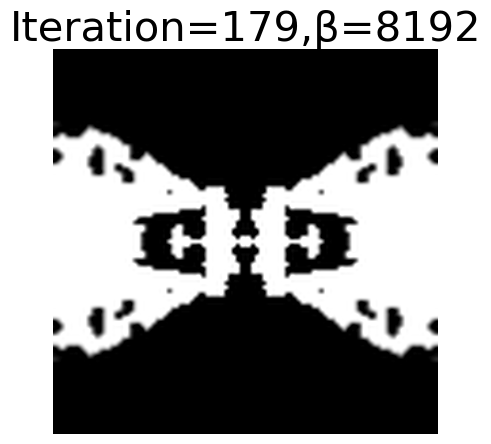

In [3]:
for i in range(1,180):
    v_array = np.load(f'Post_v_array{i:03d}.npy')
    print(v_array)
    beta_A = np.load(f'Post_beta_scale_array{i:03d}.npy')
    print(beta_A)
    eta_A = np.load(f'Post_eta_i_array{i:03d}.npy')
    print(eta_A)
    cur_A = np.load(f'Post_cur_beta_array{i:03d}.npy')
    print(cur_A)
    x_A = np.load(f'Post_x_array{i:03d}.npy')
    print(x_A)
    


    opt.update_design([mapping(v_array, eta_A, cur_A/beta_A)]) # cur_beta/beta_scale is the final beta in the optimization.
    plt.figure(figsize=(5, 5))
    plt.title(f"Iteration={i :d},β={cur_A}", fontsize=30)
    ax = plt.gca()
    opt.plot2D(
        False,
        ax=ax,
        plot_sources_flag=False,
        plot_monitors_flag=False,
        plot_boundaries_flag=False,
        output_plane = mp.Volume(center=mp.Vector3(0,0,0), size=mp.Vector3(design_region_x_width, design_region_y_height, 0))
    )
    circ = Circle((2, 2), minimum_length / 2)
    ax.add_patch(circ)
    ax.axis("off")
    plt.savefig(f'PICTURE/Picture{i:03d}.png')
    plt.show()


    

In [4]:
import os
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from PIL import Image

# Set the directory where your images are stored
image_folder = "PICTURE"
image_files = sorted([os.path.join(image_folder, f) for f in os.listdir(image_folder) if f.endswith(".png")])  # Adjust for JPG, etc.

# Load images using PIL
images = [Image.open(img) for img in image_files]

# Create figure and axis
fig, ax = plt.subplots()
ax.axis("off")  # Hide axis
im = ax.imshow(images[0])  # Initialize with the first image

# Animation function
def update(frame):
    im.set_array(images[frame])
    return [im]

# Create animation
ani = animation.FuncAnimation(fig, update, frames=len(images), interval=200, blit=True)
plt.close(fig)
# Display in Jupyter Notebook
from IPython.display import HTML
HTML(ani.to_jshtml())


In [5]:
# Convert images to GIF
output_gif = "animation.gif"

# Save images as an animated GIF
images[0].save(
    output_gif,
    save_all=True,
    append_images=images[1:],
    duration=200,  # 每幀持續時間 (毫秒)
    loop=0         # 0 表示無限循環
)

print(f"GIF 已儲存至 {output_gif}")

GIF 已儲存至 animation.gif
